<a href="https://colab.research.google.com/github/ShayEK34/DL-Assignment4-Super_Resolution/blob/main/Ass_4_Super_Resolution_improved_models.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
import glob
import cv2
import matplotlib.pyplot as plt
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from keras.preprocessing.image import ImageDataGenerator, load_img
from tensorflow import keras
from tensorflow import image

import math
from keras import backend as K
import shutil

import imageio
import numpy as np
import pandas as pd
import requests
import tarfile
import os
import tensorflow as tf
from ipywidgets import Image
from IPython import display
from pathlib import Path

# from ipywidgets import Image
# from IPython.display import Image

In [4]:
IMAGE_PATH = "VOCdevkit/VOC2007/JPEGImages"

In [5]:
if not os.path.isdir('data'):
  data = requests.get("http://host.robots.ox.ac.uk/pascal/VOC/voc2007/VOCtrainval_06-Nov-2007.tar")
  with open("data.tar", 'wb') as f:
      f.write(data.content) 

  tar = tarfile.open("data.tar")
  tar.extractall()
  tar.close()

In [6]:
file_list = glob.glob(IMAGE_PATH+'/*.jpg')
file_list[:10]

['VOCdevkit/VOC2007/JPEGImages/008536.jpg',
 'VOCdevkit/VOC2007/JPEGImages/007359.jpg',
 'VOCdevkit/VOC2007/JPEGImages/008639.jpg',
 'VOCdevkit/VOC2007/JPEGImages/003054.jpg',
 'VOCdevkit/VOC2007/JPEGImages/004034.jpg',
 'VOCdevkit/VOC2007/JPEGImages/004138.jpg',
 'VOCdevkit/VOC2007/JPEGImages/002257.jpg',
 'VOCdevkit/VOC2007/JPEGImages/002804.jpg',
 'VOCdevkit/VOC2007/JPEGImages/004281.jpg',
 'VOCdevkit/VOC2007/JPEGImages/001928.jpg']

In [7]:
num_imgs2 = 12

x2 = [] 
y_mid2 = []
y_large2 = []

for f in file_list[:num_imgs2]:
  # img = cv2.imread(f)/255.
  img = imageio.imread(f)/255.
  x2.append(cv2.resize(img, (72,72)))
  y_mid2.append(cv2.resize(img, (144,144)))
  y_large2.append(cv2.resize(img, (288,288)))

x2 = np.array(x2)
y_mid2 = np.array(y_mid2)
y_large2 = np.array(y_large2)

x2.shape, y_mid2.shape, y_large2.shape

((12, 72, 72, 3), (12, 144, 144, 3), (12, 288, 288, 3))

In [8]:
if not (os.path.isdir('train_dir')):
  base_dir = 'train_dir'
  os.mkdir(base_dir)
  shutil.move(IMAGE_PATH, "train_dir")

In [9]:
new_images_path = 'train_dir'

In [10]:
def PSNR_as_loss(y_true, y_pred):
  return -image.psnr(y_true, y_pred,1)

In [11]:
def PSNR(y_true, y_pred):
  return image.psnr(y_true, y_pred,1)

In [12]:
images_pred_per_epoch = {}
images_per_epoch = x2
class PredictionCallback(tf.keras.callbacks.Callback):
  def __init__(self,model_name):
    super().__init__()
    self.model_name = model_name
    images_pred_per_epoch[model_name] = []
  def on_epoch_end(self, epoch, logs={}):
    pred = self.model.predict(images_per_epoch)
    images_pred_per_epoch[self.model_name].append(pred)

In [13]:
def create_callbacks(model_name='base', patience=5, factor=0.1, monitor='val_loss', save_best=True):
    es = EarlyStopping(monitor=monitor, patience=patience, verbose=1,)
    rlr = ReduceLROnPlateau(monitor=monitor, factor=factor, patience=patience)
    model_ckpt = ModelCheckpoint(f'./{model_name}.h5', monitor=monitor, save_best_only=save_best)
    predictions_per_epoch = PredictionCallback(model_name)
    return [es, rlr, model_ckpt,predictions_per_epoch]

In [14]:
def take_images_for_gif(model_name,index_image_size,num_image):
  model_images = images_pred_per_epoch[model_name]
  images_gif = []
  for i in range(0,len(model_images)):
      # images_gif.append(model_images[i][index_image_size])
      if index_image_size == -1:
        data = model_images[i][num_image]
      else:
        data = model_images[i][index_image_size][num_image]
      data = data / data.max() #normalizes data in range 0 - 255
      data = 255 * data
      img = data.astype(np.uint8)
      images_gif.append(img)

  return images_gif

In [15]:
def create_gif(model_name,index_image_size,img_index):
  images_for_gif = take_images_for_gif(model_name,index_image_size,img_index)
  imageio.mimwrite(f'./{model_name}.gif', images_for_gif)

  animatedGif = model_name+'.gif' #path relative to your notebook
  file = open(animatedGif , "rb")
  image = file.read()
  progress= Image(value=image,format='gif', width=250,height=100)
  display.display(progress)

In [16]:
scores_metric_mse = ["Out_Med_mse","Out_Large_mse","val_Out_Med_mse","val_Out_Large_mse"]

scores_metric_psnr = ["Out_Med_PSNR","Out_Large_PSNR","val_Out_Med_PSNR","val_Out_Large_PSNR"]

losses = ['loss',"Out_Med_loss","Out_Large_loss","val_Out_Med_loss","val_Out_Large_loss"]

In [17]:
def history_to_plot(history, scores, losses):

  history = history.history
  fig, ax = plt.subplots(1,2,figsize=(12,4))

  for score in scores:
      ax[0].plot(history[score])

  ax[0].set_title('Model score')
  ax[0].set_ylabel('Score')
  ax[0].set_xlabel('Epoch')
  ax[0].legend(scores, loc='lower right')

 
  for loss in losses:
    ax[1].plot(history[loss])

  ax[1].set_title('Model loss')
  ax[1].set_ylabel('Loss')
  ax[1].set_xlabel('Epoch')

  ax[1].legend(losses, loc='upper right')
  plt.show()  

In [18]:
def plot_multi_imgs_pred (index,x,original,pred,output_type):
  fig, ax = plt.subplots(1,3,figsize=(18,5))
  ax[0].set_title('Original size 72x72')
  ax[0].imshow(x[index])
  if output_type == 0:
    ax[1].set_title('Original size 144x144')
    ax[1].imshow(original[index])
    ax[2].set_title('Prediction size 144*144')
    ax[2].imshow(pred[index])
  else:
    ax[1].set_title('Original size 288x288')
    ax[1].imshow(original[index])
    ax[2].set_title('Prediction size 288x288')
    ax[2].imshow(pred[index])

In [19]:
def plot_three_images_pred(num,x,original,pred,output_type):
  for i in range(0,3):
    plot_multi_imgs_pred(num,x,original,pred,output_type)
    num = num+1

In [20]:
EPOCHS_NUM = 20

In [21]:
class UnionDataGenerator(keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, path, batch_size,interpolation, mode):
      self.path = path
      self.batch_size = batch_size
      self.mode = mode
        # 'Initialization'
        # self.dim = dim
        # self.files = files
        # self.batch_size = batch_size
        # self.n_channels = n_channels
        # self.n_classes = n_classes
        # self.shuffle = shuffle
        # self.on_epoch_end()

      generator1 = ImageDataGenerator(rescale=1./255,validation_split=0.2)
      generator2 = ImageDataGenerator(rescale=1./255,validation_split=0.2)
      generator3 = ImageDataGenerator(rescale=1./255,validation_split=0.2)

    # 'bicubic'
    # 'nearest'
    # 'bilinear'

      data_gen1= generator1.flow_from_directory(directory  = self.path,
                                                target_size=(72,72),
                                                color_mode = 'rgb',
                                                seed =7,
                                                interpolation =interpolation,
                                                batch_size = self.batch_size,
                                                shuffle = False,
                                                class_mode =None,
                                                subset= self.mode)
      
      data_gen2= generator2.flow_from_directory(directory = self.path,
                                                target_size=(144,144),
                                                color_mode = 'rgb',
                                                seed =7,
                                                interpolation =interpolation,
                                                batch_size = self.batch_size,
                                                shuffle = False,
                                                class_mode =None,
                                                subset=self.mode)

      data_gen3= generator3.flow_from_directory(directory = self.path,
                                                target_size=(288,288),
                                                color_mode = 'rgb',
                                                seed =7,
                                                interpolation =interpolation,
                                                batch_size = self.batch_size,
                                                shuffle = False,
                                                class_mode =None,
                                                subset=self.mode)
      self.data_gen1 = data_gen1
      self.data_gen2 = data_gen2
      self.data_gen3 = data_gen3

    def __len__(self):
      return len(self.data_gen1)

    def __getitem__(self, index):
      x1 = self.data_gen1[index]
      x2 = self.data_gen2[index]
      x3 = self.data_gen3[index]
      return x1, [x2,x3]

    def on_epoch_end(self):
      self.data_gen1.on_epoch_end()
      self.data_gen2.on_epoch_end()
      self.data_gen3.on_epoch_end()

# **Model 4.1 improved**

In [22]:
def dilated_conv(cnl):
  inp = Input(shape = (None,None,cnl))
  d1 = Conv2D(cnl,3,activation=LeakyReLU(alpha=0.2),padding='same',dilation_rate=1)(inp)
  d2 = Conv2D(cnl,3,activation=LeakyReLU(alpha=0.2),padding='same',dilation_rate=2)(inp)
  d3 = Conv2D(cnl,3,activation=LeakyReLU(alpha=0.2),padding='same',dilation_rate=4)(inp)
  c = concatenate([d1,d2,d3],axis=-1)
  a = LeakyReLU(alpha=0.2)(c)
  out = Conv2D(cnl,3,padding='same')(a)
  return Model(inp,out)

## **Define model 4.1 with loss as PSNR**

In [21]:
def dilated_model_2_loss_psnr():
  inp = Input(shape = (None,None,3))
  x= Conv2D(32,1)(inp)
  x = Activation(LeakyReLU(alpha=0.2))(x)

  x = dilated_conv(32)(x)
  x = dilated_conv(32)(x)

  x = UpSampling2D(interpolation='bilinear')(x)
  y1 = Conv2D(3,1,padding='same')(x)
  y1 = Activation('sigmoid',name = 'Out_Med')(y1)
  
  x = dilated_conv(32)(x)
  x = dilated_conv(32)(x)
  x = dilated_conv(32)(x)

  x = UpSampling2D(interpolation='bilinear')(x)
  y2 = Conv2D(3,1,padding='same')(x)
  y2 = Activation('sigmoid',name = 'Out_Large')(y2)
  model_del = Model(inp,[y1,y2])
  model_del.compile(loss=PSNR_as_loss,optimizer='adam',metrics=['acc','mse'])
  return model_del

model_del_2 = dilated_model_2_loss_psnr()
model_del_2.summary()

Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 128         input_1[0][0]                    
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           conv2d[0][0]                     
__________________________________________________________________________________________________
model (Functional)              (None, None, None, 3 55424       activation[0][0]                 
____________________________________________________________________________________________

## **Trainning model 4.1.1 with interpolation bicucic and loss PSNR**

In [22]:
history_4_1_1 = model_del_2.fit(UnionDataGenerator(new_images_path,16,'bicubic','training'),
               callbacks=[create_callbacks('model_4_1_1')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'bicubic','validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 158s 589ms/step - loss: -37.4885 - Out_Med_loss: -19.3932 - Out_Large_loss: -18.0953 - Out_Med_acc: 0.6784 - Out_Med_mse: 0.0218 - Out_Large_acc: 0.5965 - Out_Large_mse: 0.0245 - val_loss: -48.8789 - val_Out_Med_loss: -25.7751 - val_Out_Large_loss: -23.1037 - val_Out_Med_acc: 0.7787 - val_Out_Med_mse: 0.0031 - val_Out_Large_acc: 0.7216 - val_Out_Large_mse: 0.0059
Epoch 2/20
250/250 [==============================] - 145s 578ms/step - loss: -49.2559 - Out_Med_loss: -26.0337 - Out_Large_loss: -23.2223 - Out_Med_acc: 0.7964 - Out_Med_mse: 0.0029 - Out_Large_acc: 0.7301 - Out_Large_mse: 0.0056 - val_loss: -51.0455 - val_Out_Med_loss: -27.0524 - val_Out_Large_loss: -23.9931 - val_Out_Med_ac

In [23]:
pred1,pred2 = model_del_2.predict(x2)

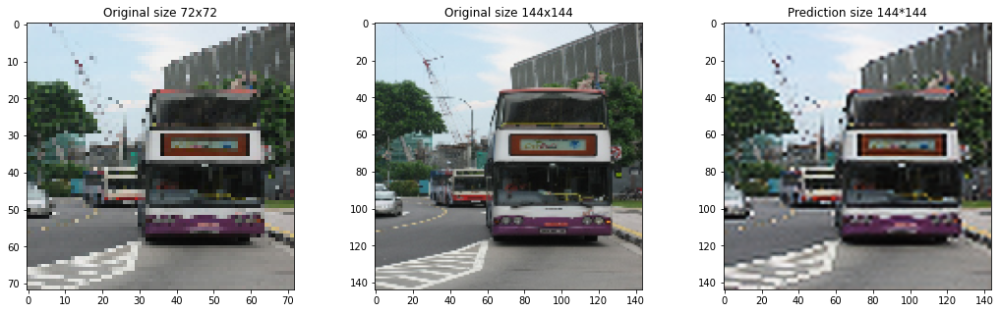

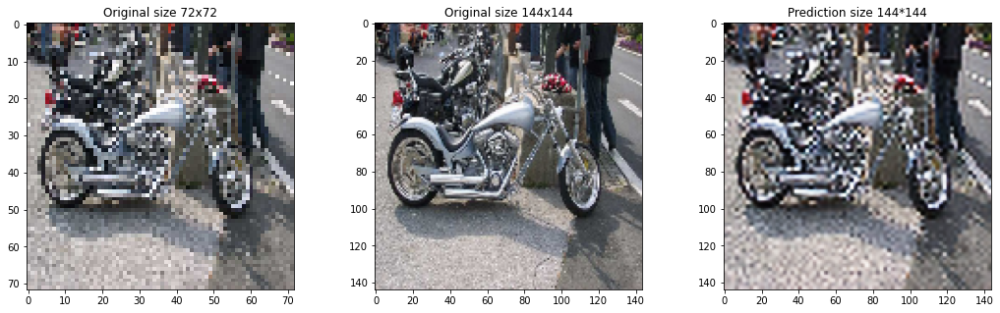

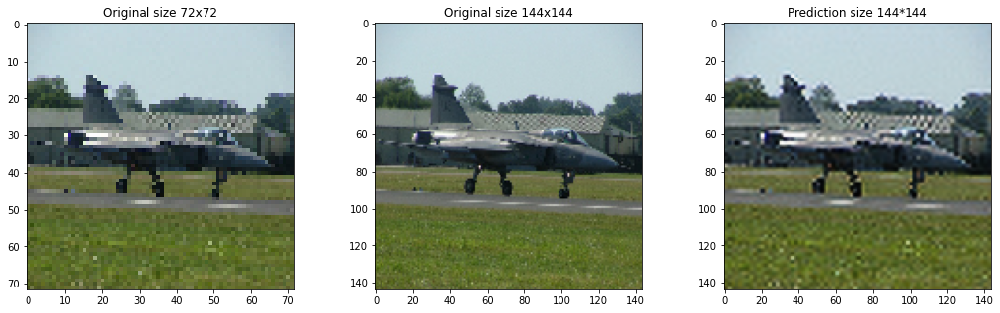

In [24]:
plot_three_images_pred(9,x2,y_mid2,pred1,0)

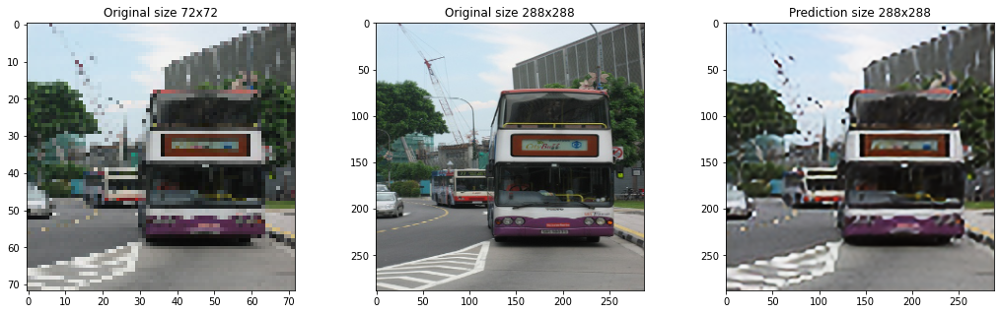

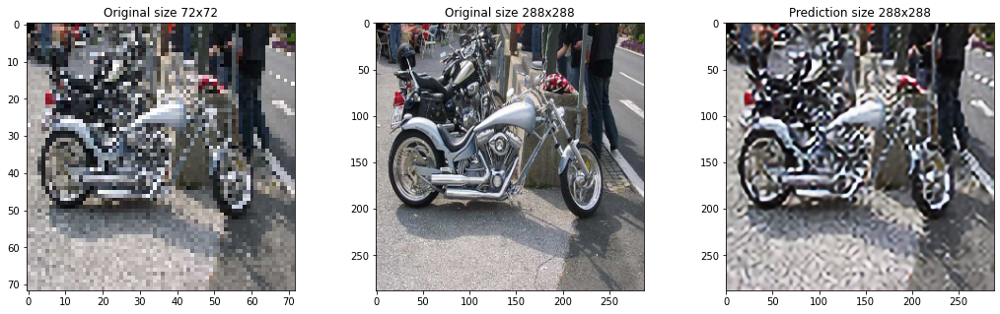

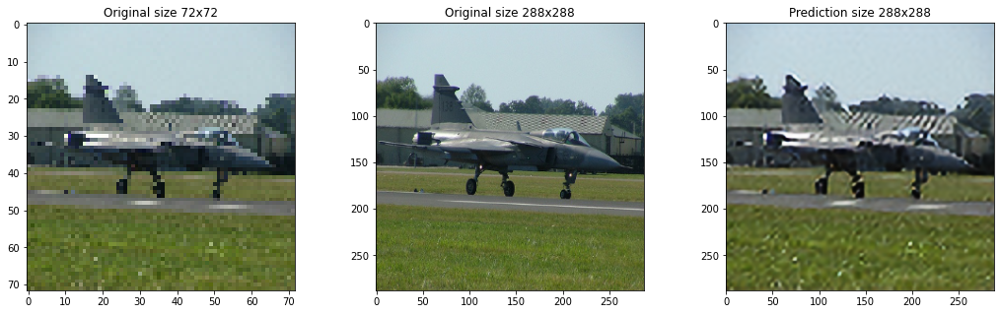

In [25]:
plot_three_images_pred(9,x2,y_large2,pred2,1)

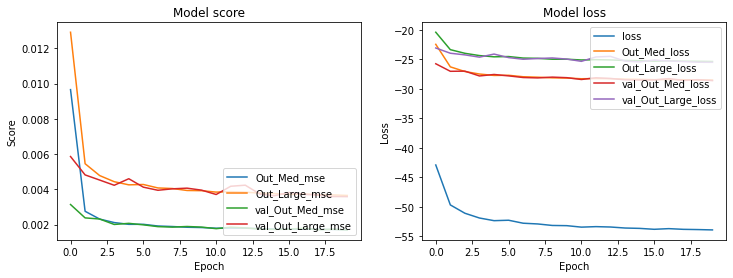

In [26]:
history_to_plot(history_4_1_1, scores_metric_mse, losses)

## **Trainning model 4.1.2 with interpolation nearest and loss PSNR**

In [27]:
history_4_1_2 = model_del_2.fit(UnionDataGenerator(new_images_path,16,'nearest','training'),
               callbacks=[create_callbacks('model_4_1_2')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'nearest','validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 130s 521ms/step - loss: -42.7544 - Out_Med_loss: -21.2930 - Out_Large_loss: -21.4615 - Out_Med_acc: 0.8351 - Out_Med_mse: 0.0097 - Out_Large_acc: 0.8245 - Out_Large_mse: 0.0093 - val_loss: -43.0288 - val_Out_Med_loss: -21.3953 - val_Out_Large_loss: -21.6335 - val_Out_Med_acc: 0.8287 - val_Out_Med_mse: 0.0094 - val_Out_Large_acc: 0.7884 - val_Out_Large_mse: 0.0089
Epoch 2/20
250/250 [==============================] - 130s 519ms/step - loss: -43.0547 - Out_Med_loss: -21.3949 - Out_Large_loss: -21.6599 - Out_Med_acc: 0.8400 - Out_Med_mse: 0.0095 - Out_Large_acc: 0.8298 - Out_Large_mse: 0.0089 - val_loss: -42.8901 - val_Out_Med_loss: -21.3686 - val_Out_Large_loss: -21.5215 - val_Out_Med_ac

In [28]:
pred1,pred2 = model_del_2.predict(x2)

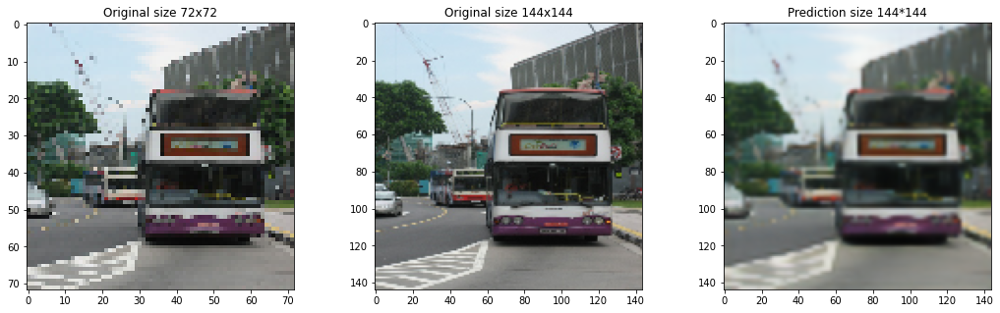

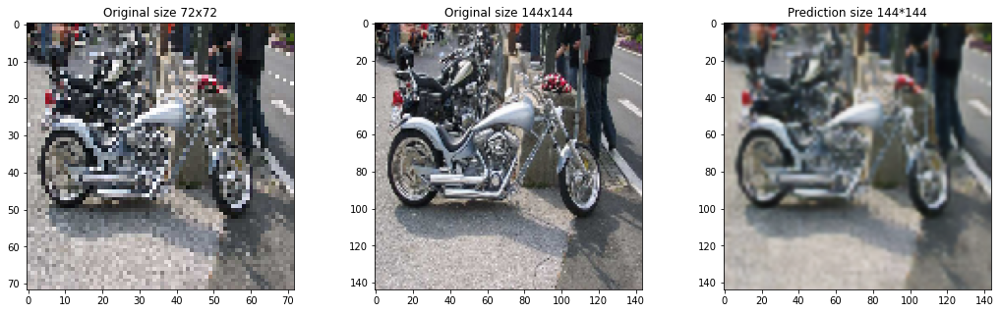

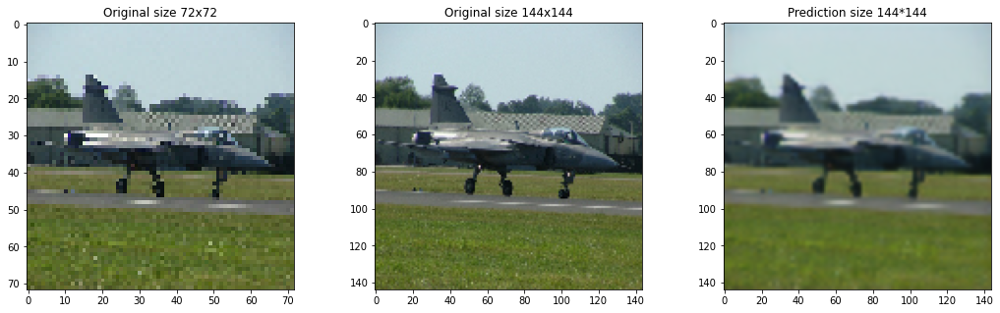

In [29]:
plot_three_images_pred(9,x2,y_mid2,pred1,0)

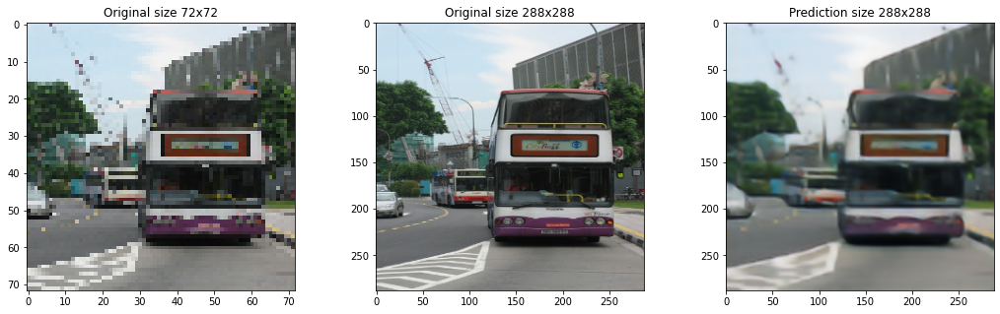

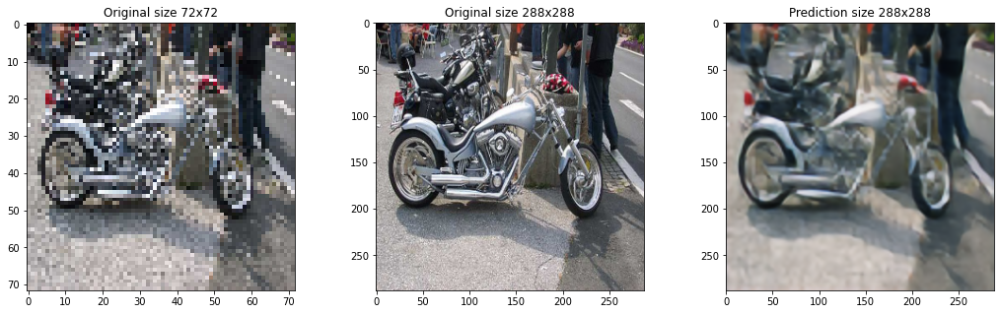

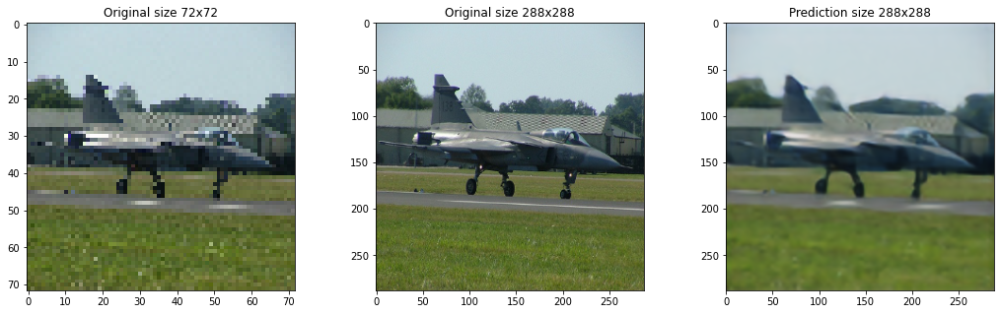

In [30]:
plot_three_images_pred(9,x2,y_large2,pred2,1)

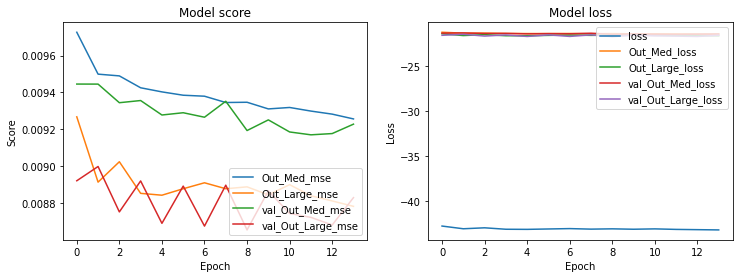

In [31]:
history_to_plot(history_4_1_2, scores_metric_mse, losses)

## **Trainning model 4.1.3 with interpolation bilinear and loss PSNR**

In [32]:
history_4_1_3 = model_del_2.fit(UnionDataGenerator(new_images_path,16,'bilinear','training'),
               callbacks=[create_callbacks('model_4_1_3')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'bilinear','validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 134s 534ms/step - loss: -56.2744 - Out_Med_loss: -29.7789 - Out_Large_loss: -26.4955 - Out_Med_acc: 0.8809 - Out_Med_mse: 0.0013 - Out_Large_acc: 0.8574 - Out_Large_mse: 0.0029 - val_loss: -56.8904 - val_Out_Med_loss: -30.1438 - val_Out_Large_loss: -26.7466 - val_Out_Med_acc: 0.8993 - val_Out_Med_mse: 0.0012 - val_Out_Large_acc: 0.8813 - val_Out_Large_mse: 0.0027
Epoch 2/20
250/250 [==============================] - 133s 530ms/step - loss: -57.1755 - Out_Med_loss: -30.3015 - Out_Large_loss: -26.8740 - Out_Med_acc: 0.8887 - Out_Med_mse: 0.0012 - Out_Large_acc: 0.8709 - Out_Large_mse: 0.0027 - val_loss: -57.2346 - val_Out_Med_loss: -30.3216 - val_Out_Large_loss: -26.9129 - val_Out_Med_ac

In [33]:
pred1,pred2 = model_del_2.predict(x2)

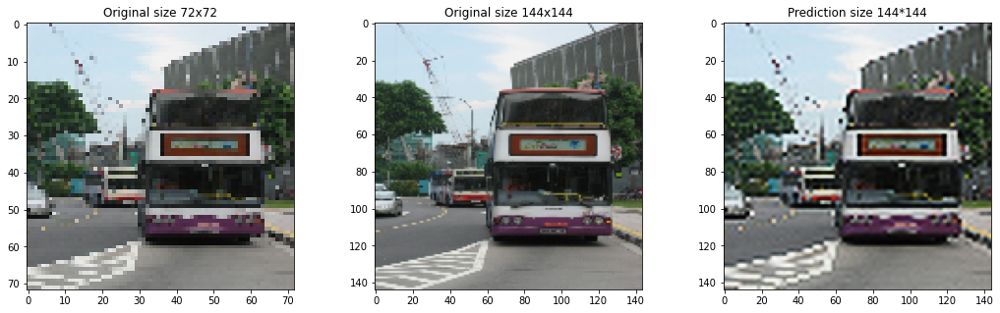

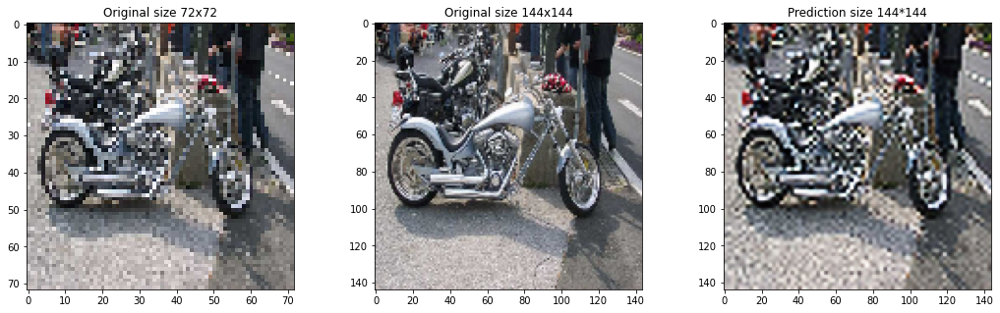

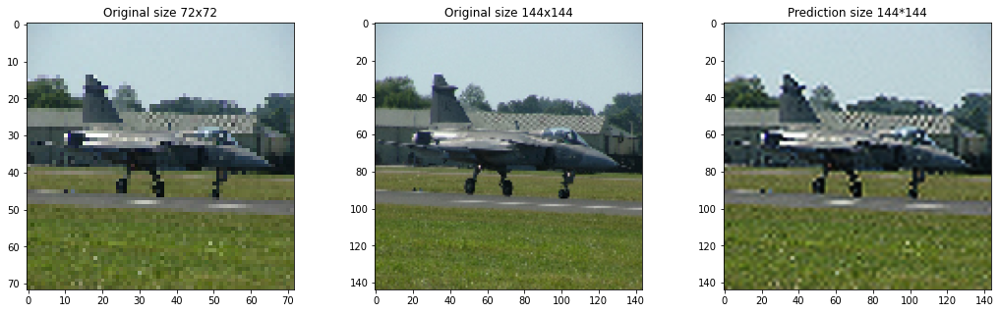

In [34]:
plot_three_images_pred(9,x2,y_mid2,pred1,0)

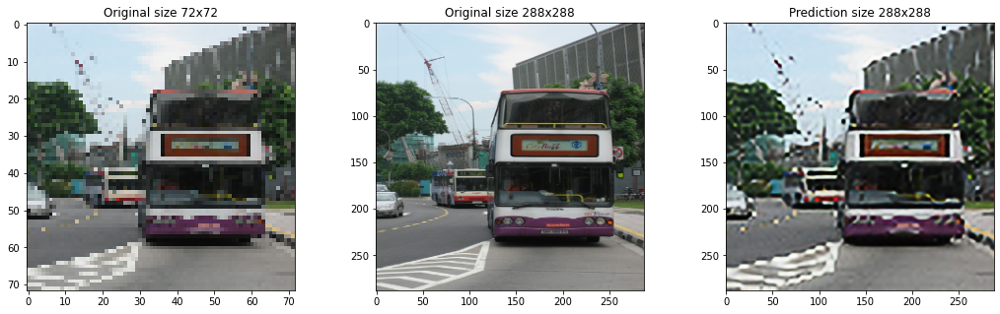

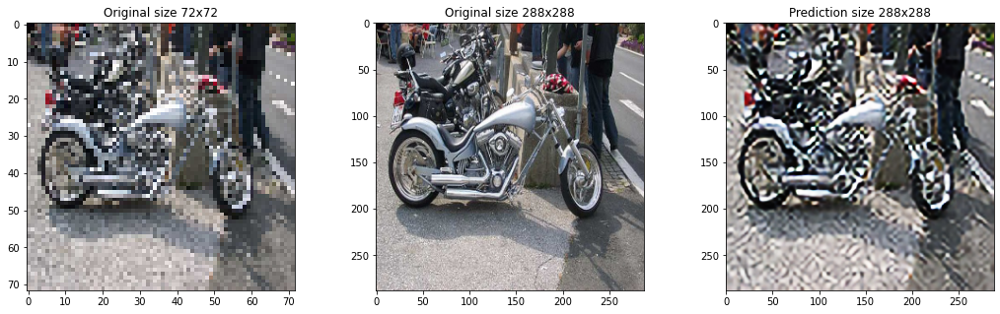

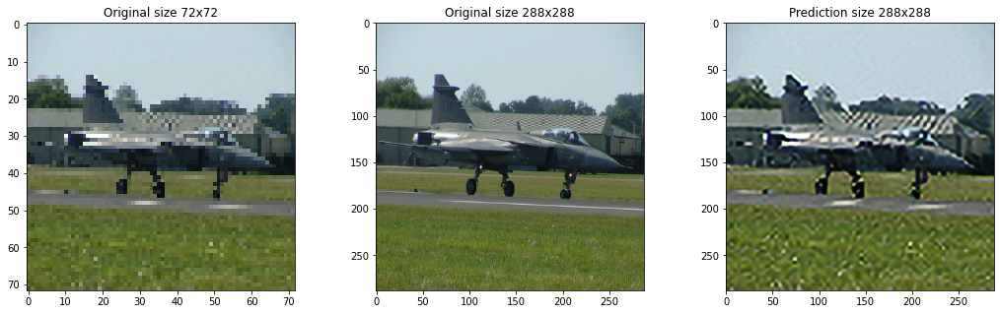

In [35]:
plot_three_images_pred(9,x2,y_large2,pred2,1)

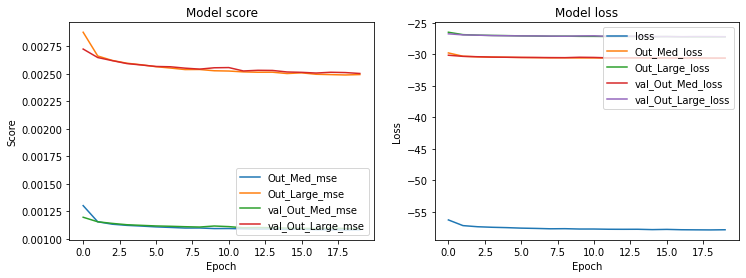

In [36]:
history_to_plot(history_4_1_3, scores_metric_mse, losses)

## **Define model 4.1 with loss as MSE**

In [37]:
def dilated_model_2_loss_mse():
  inp = Input(shape = (None,None,3))
  x= Conv2D(32,1)(inp)
  x = Activation(LeakyReLU(alpha=0.2))(x)

  x = dilated_conv(32)(x)
  x = dilated_conv(32)(x)

  x = UpSampling2D(interpolation='bilinear')(x)
  y1 = Conv2D(3,1,padding='same')(x)
  y1 = Activation('sigmoid',name = 'Out_Med')(y1)
  
  x = dilated_conv(32)(x)
  x = dilated_conv(32)(x)
  x = dilated_conv(32)(x)

  x = UpSampling2D(interpolation='bilinear')(x)
  y2 = Conv2D(3,1,padding='same')(x)
  y2 = Activation('sigmoid',name = 'Out_Large')(y2)
  model_del = Model(inp,[y1,y2])

  model_del.compile(loss='mse',optimizer='adam',metrics=['acc',PSNR])
  return model_del

model_del_2 = dilated_model_2_loss_mse()
model_del_2.summary()

Model: "model_11"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_23 (Conv2D)              (None, None, None, 3 128         input_7[0][0]                    
__________________________________________________________________________________________________
activation_1 (Activation)       (None, None, None, 3 0           conv2d_23[0][0]                  
__________________________________________________________________________________________________
model_6 (Functional)            (None, None, None, 3 55424       activation_1[0][0]               
___________________________________________________________________________________________

## **Trainning model 4.1.4 with interpolation bicucic and loss MSE**

In [38]:
history_4_1_4 = model_del_2.fit(UnionDataGenerator(new_images_path,16,'bicubic','training'),
               callbacks=[create_callbacks('model_4_1_4')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'bicubic','validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 140s 546ms/step - loss: 0.0588 - Out_Med_loss: 0.0289 - Out_Large_loss: 0.0299 - Out_Med_acc: 0.5826 - Out_Med_PSNR: 18.0439 - Out_Large_acc: 0.5621 - Out_Large_PSNR: 17.3421 - val_loss: 0.0104 - val_Out_Med_loss: 0.0040 - val_Out_Large_loss: 0.0063 - val_Out_Med_acc: 0.7791 - val_Out_Med_PSNR: 24.5587 - val_Out_Large_acc: 0.7493 - val_Out_Large_PSNR: 22.7598
Epoch 2/20
250/250 [==============================] - 136s 543ms/step - loss: 0.0093 - Out_Med_loss: 0.0035 - Out_Large_loss: 0.0059 - Out_Med_acc: 0.7818 - Out_Med_PSNR: 25.2502 - Out_Large_acc: 0.7475 - Out_Large_PSNR: 23.0927 - val_loss: 0.0077 - val_Out_Med_loss: 0.0027 - val_Out_Large_loss: 0.0050 - val_Out_Med_acc: 0.8022 - 

In [39]:
pred1,pred2 = model_del_2.predict(x2)

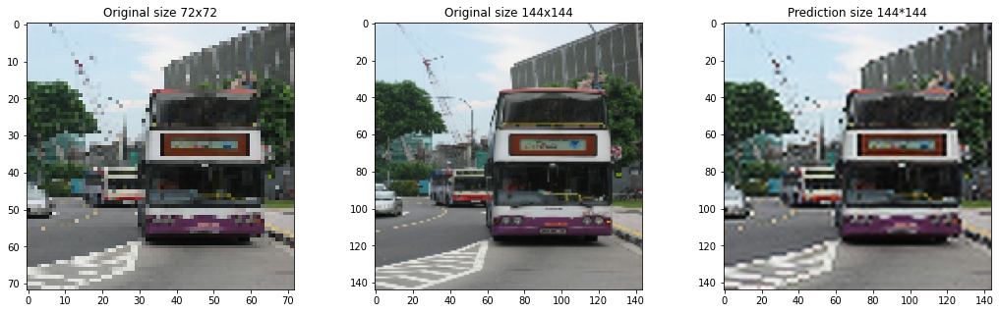

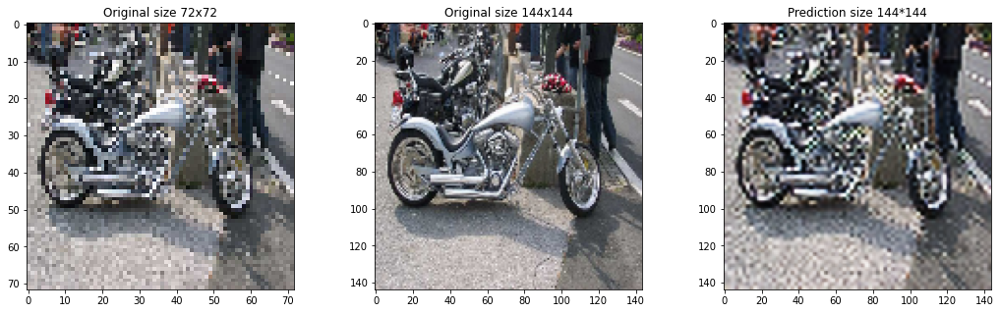

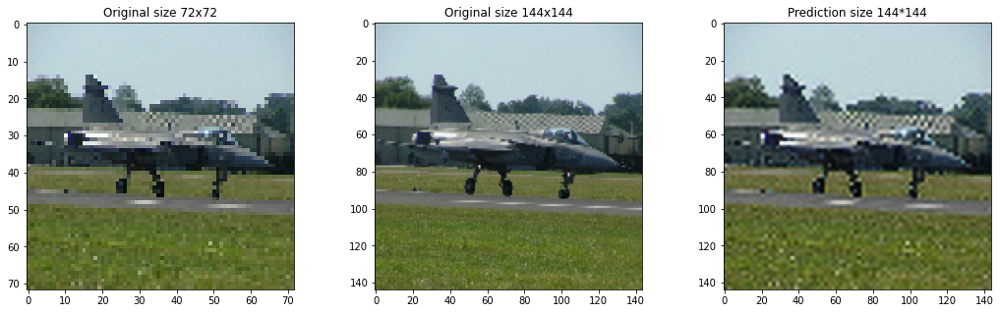

In [40]:
plot_three_images_pred(9,x2,y_mid2,pred1,0)

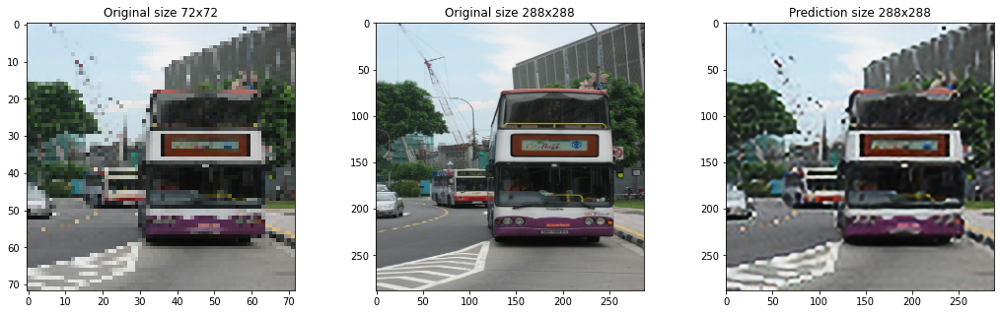

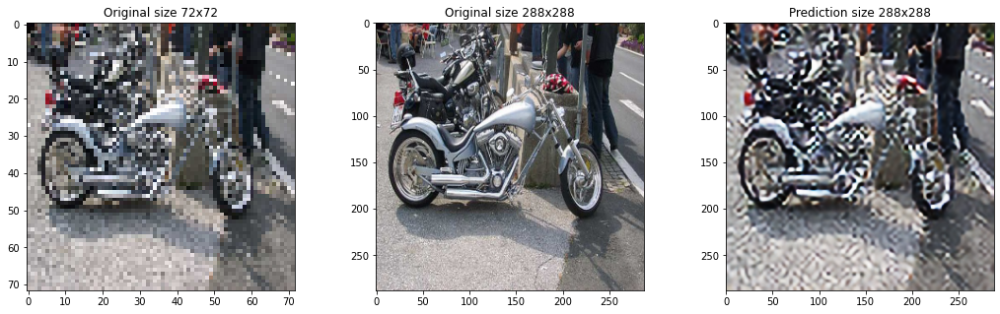

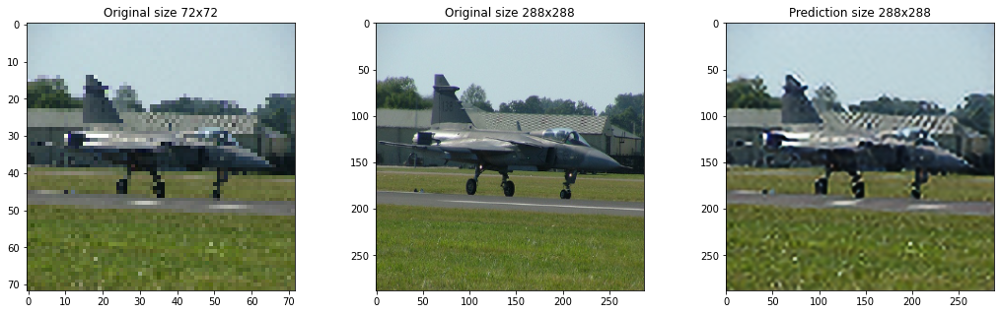

In [41]:
plot_three_images_pred(9,x2,y_large2,pred2,1)

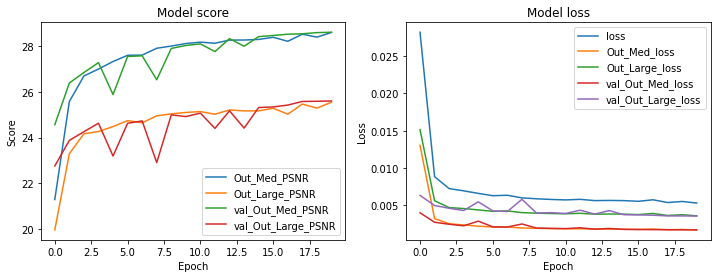

In [42]:
history_to_plot(history_4_1_4, scores_metric_psnr, losses)

## **Trainning model 4.1.5 with interpolation nearest and loss MSE**

In [43]:
history_4_1_5 = model_del_2.fit(UnionDataGenerator(new_images_path,16,'nearest','training'),
               callbacks=[create_callbacks('model_4_1_5')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'nearest','validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 129s 514ms/step - loss: 0.0197 - Out_Med_loss: 0.0098 - Out_Large_loss: 0.0099 - Out_Med_acc: 0.8101 - Out_Med_PSNR: 21.1812 - Out_Large_acc: 0.7859 - Out_Large_PSNR: 21.0856 - val_loss: 0.0186 - val_Out_Med_loss: 0.0095 - val_Out_Large_loss: 0.0091 - val_Out_Med_acc: 0.8403 - val_Out_Med_PSNR: 21.3241 - val_Out_Large_acc: 0.8224 - val_Out_Large_PSNR: 21.4720
Epoch 2/20
250/250 [==============================] - 128s 512ms/step - loss: 0.0186 - Out_Med_loss: 0.0095 - Out_Large_loss: 0.0091 - Out_Med_acc: 0.8231 - Out_Med_PSNR: 21.3648 - Out_Large_acc: 0.8113 - Out_Large_PSNR: 21.4996 - val_loss: 0.0184 - val_Out_Med_loss: 0.0094 - val_Out_Large_loss: 0.0090 - val_Out_Med_acc: 0.8423 - 

In [44]:
pred1,pred2 = model_del_2.predict(x2)

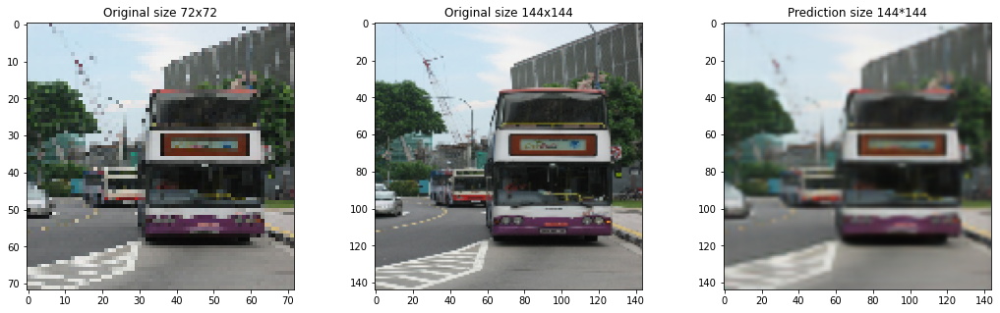

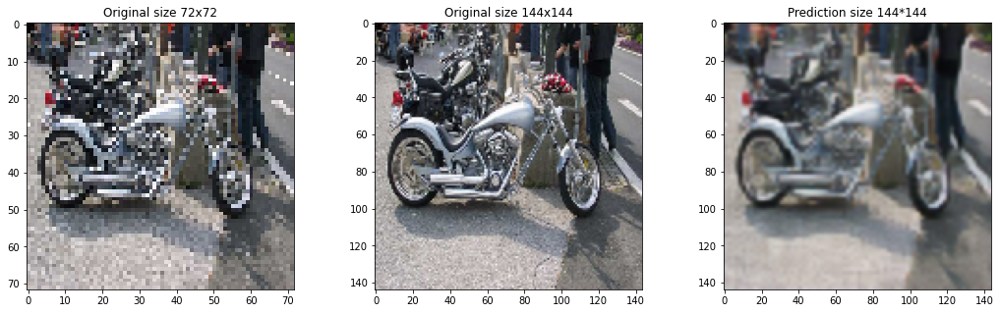

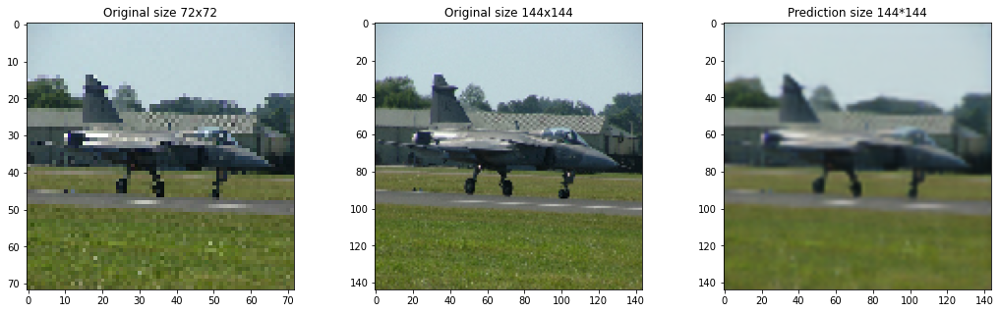

In [45]:
plot_three_images_pred(9,x2,y_mid2,pred1,0)

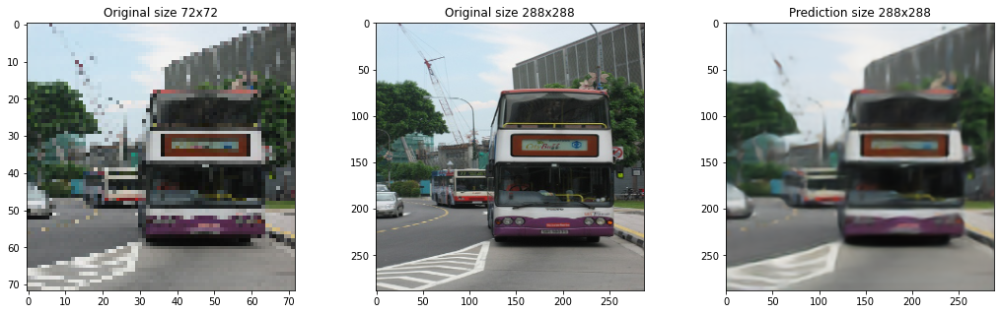

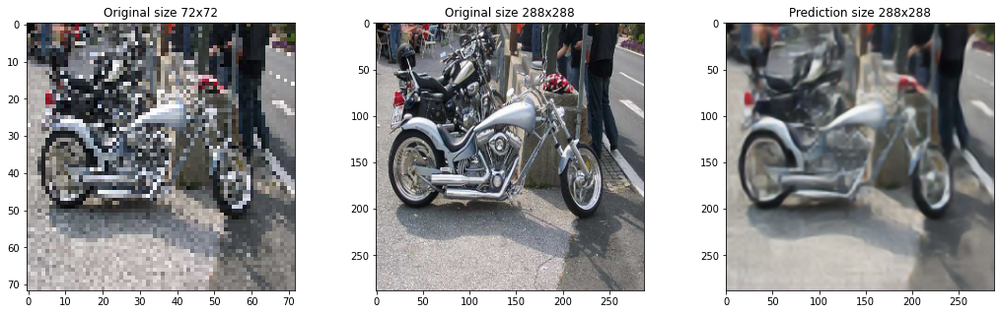

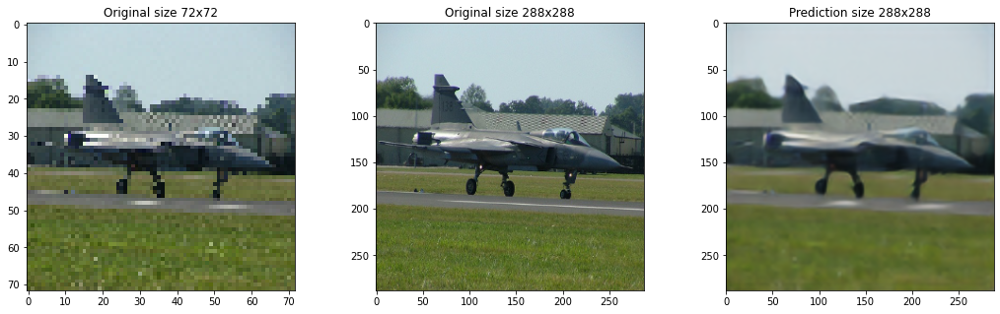

In [46]:
plot_three_images_pred(9,x2,y_large2,pred2,1)

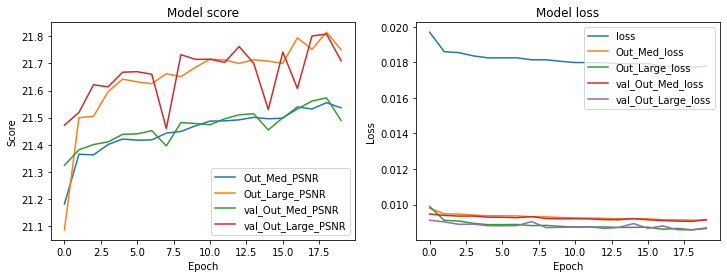

In [47]:
history_to_plot(history_4_1_5, scores_metric_psnr, losses)

## **Trainning model 4.1.6 with interpolation bilinear and loss MSE**

In [48]:
history_4_1_6 = model_del_2.fit(UnionDataGenerator(new_images_path,16,'bilinear','training'),
               callbacks=[create_callbacks('model_4_1_6')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'bilinear','validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 133s 532ms/step - loss: 0.0041 - Out_Med_loss: 0.0013 - Out_Large_loss: 0.0029 - Out_Med_acc: 0.8744 - Out_Med_PSNR: 29.8748 - Out_Large_acc: 0.8446 - Out_Large_PSNR: 26.4712 - val_loss: 0.0039 - val_Out_Med_loss: 0.0012 - val_Out_Large_loss: 0.0027 - val_Out_Med_acc: 0.8719 - val_Out_Med_PSNR: 30.2203 - val_Out_Large_acc: 0.8327 - val_Out_Large_PSNR: 26.7824
Epoch 2/20
250/250 [==============================] - 132s 528ms/step - loss: 0.0038 - Out_Med_loss: 0.0012 - Out_Large_loss: 0.0027 - Out_Med_acc: 0.8800 - Out_Med_PSNR: 30.2570 - Out_Large_acc: 0.8479 - Out_Large_PSNR: 26.7800 - val_loss: 0.0038 - val_Out_Med_loss: 0.0012 - val_Out_Large_loss: 0.0027 - val_Out_Med_acc: 0.8832 - 

In [49]:
pred1,pred2 = model_del_2.predict(x2)

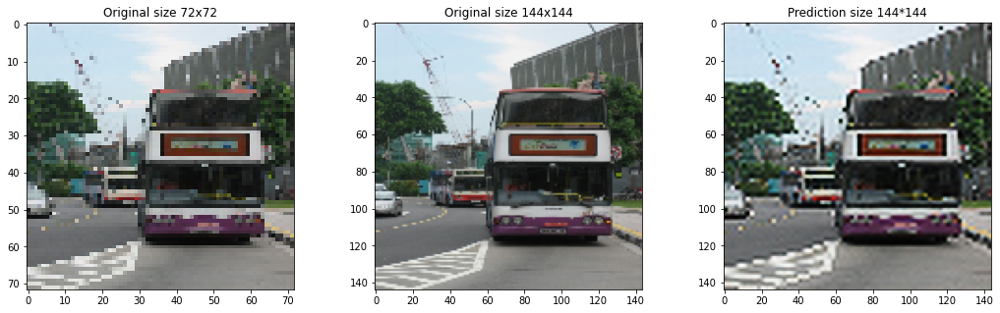

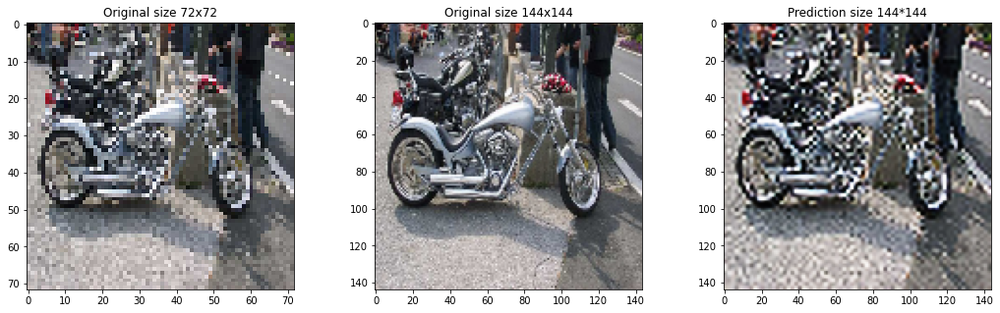

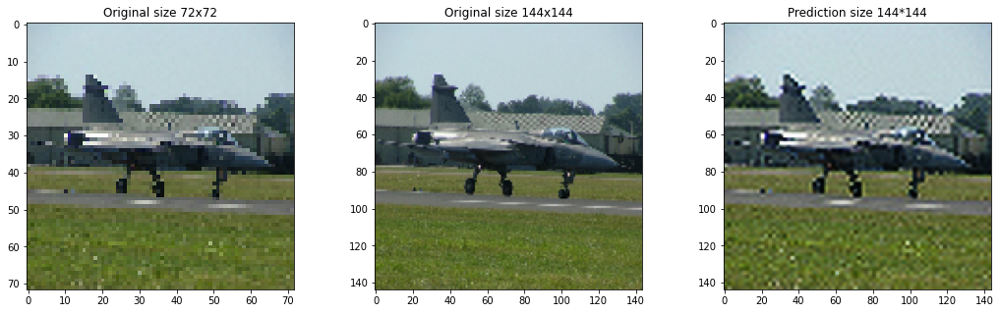

In [50]:
plot_three_images_pred(9,x2,y_mid2,pred1,0)

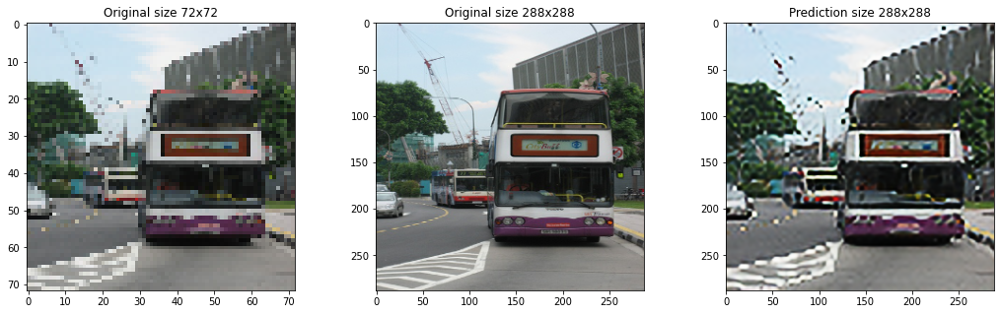

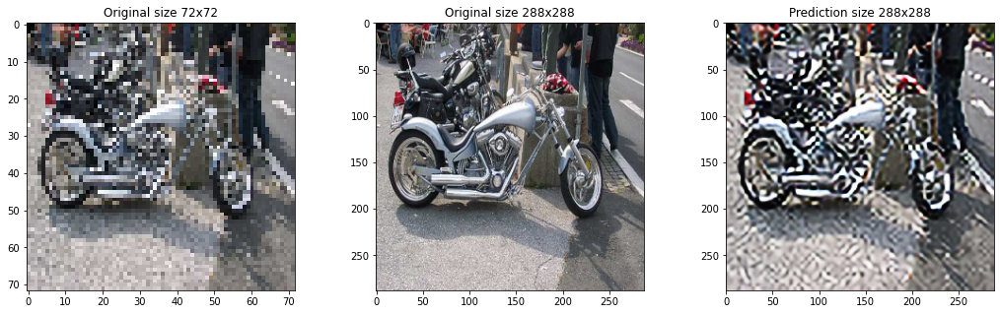

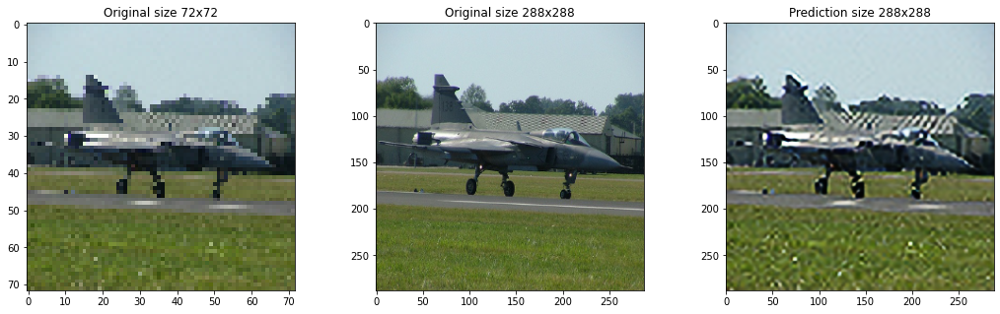

In [51]:
plot_three_images_pred(9,x2,y_large2,pred2,1)

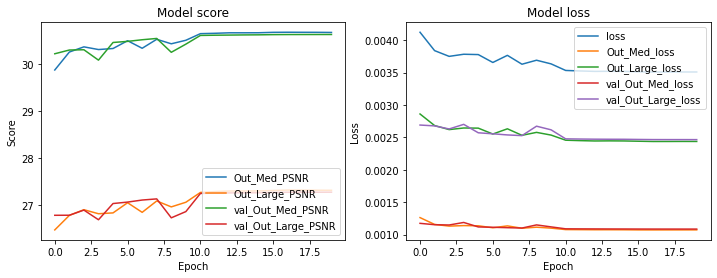

In [52]:
history_to_plot(history_4_1_6, scores_metric_psnr, losses)

# **Model 5.1 improved**

In [23]:
# step 6
from tensorflow.keras.applications.vgg16 import VGG16

In [24]:
vgg = VGG16(weights = 'imagenet', include_top = False)
fe_model = Model(vgg.input,vgg.layers[2].output)
fe_model.summary()

58892288/58889256 [==============================] - 0s 0us/step
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
Total params: 38,720
Trainable params: 38,720
Non-trainable params: 0
_________________________________________________________________


In [25]:
for l in fe_model.layers:
  l.trainable = False

In [26]:
fe_model.compile(loss = 'mse',optimizer='adam')

## **Define model 5.1 with loss as PSNR**

In [25]:
def get_model_with_vgg_v2_loss_psnr():

  inp = Input(shape=(None,None,3))
  x1 = Conv2D(64,8,activation=Activation(LeakyReLU(alpha=0.2)), padding = 'same')(inp)
  x1 = dilated_conv(64)(x1)
  x1 = dilated_conv(64)(x1)

  x2 = Conv2D(64,4,activation=Activation(LeakyReLU(alpha=0.2)), padding = 'same')(inp)
  x2 = dilated_conv(64)(x2)
  x2 = dilated_conv(64)(x2)

  x3 = Conv2D(64,2,activation=Activation(LeakyReLU(alpha=0.2)), padding = 'same')(inp)
  x3 = dilated_conv(64)(x3)
  x3 = dilated_conv(64)(x3)


  y = fe_model(inp)
  x = concatenate([x1,x2,x3,y],axis=-1)

  x = UpSampling2D(interpolation='bilinear')(x)

  y1 =Conv2D(3,1, padding='same')(x)
  y1 = Activation('sigmoid',name = 'Out_Med')(y1)

  x = Conv2D(64,1)(x)
  
  x = UpSampling2D(interpolation='bilinear')(x)

  y2 = Conv2D(3,1,padding='same')(x)
  y2 = Activation('sigmoid',name = 'Out_Large')(y2)

  model_with_vgg_v2 = Model(inp,[y1,y2])
  model_with_vgg_v2.compile(loss=PSNR_as_loss,optimizer='adam',metrics=['acc','mse'])
  return model_with_vgg_v2

In [26]:
model_with_vgg_v2 = get_model_with_vgg_v2_loss_psnr()
model_with_vgg_v2.summary()

Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 6 12352       input_2[0][0]                    
__________________________________________________________________________________________________
conv2d_9 (Conv2D)               (None, None, None, 6 3136        input_2[0][0]                    
__________________________________________________________________________________________________
conv2d_18 (Conv2D)              (None, None, None, 6 832         input_2[0][0]                    
____________________________________________________________________________________________

## **Trainning model 5.1.1 with interpolation bicucic and loss PSNR**

In [27]:
history_5_1_1 = model_with_vgg_v2.fit(UnionDataGenerator(new_images_path,16,'bicubic','training'),
               callbacks=[create_callbacks('model_5_1_1')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'bicubic','validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 123s 449ms/step - loss: -38.4763 - Out_Med_loss: -19.8754 - Out_Large_loss: -18.6010 - Out_Med_acc: 0.6306 - Out_Med_mse: 0.0218 - Out_Large_acc: 0.6453 - Out_Large_mse: 0.0279 - val_loss: -49.6240 - val_Out_Med_loss: -26.2131 - val_Out_Large_loss: -23.4108 - val_Out_Med_acc: 0.7711 - val_Out_Med_mse: 0.0028 - val_Out_Large_acc: 0.7529 - val_Out_Large_mse: 0.0054
Epoch 2/20
250/250 [==============================] - 111s 444ms/step - loss: -50.1764 - Out_Med_loss: -26.4906 - Out_Large_loss: -23.6858 - Out_Med_acc: 0.7921 - Out_Med_mse: 0.0026 - Out_Large_acc: 0.7690 - Out_Large_mse: 0.0051 - val_loss: -48.1268 - val_Out_Med_loss: -25.2945 - val_Out_Large_loss: -22.8323 - val_Out_Med_ac

In [28]:
pred1,pred2 = model_with_vgg_v2.predict(x2)

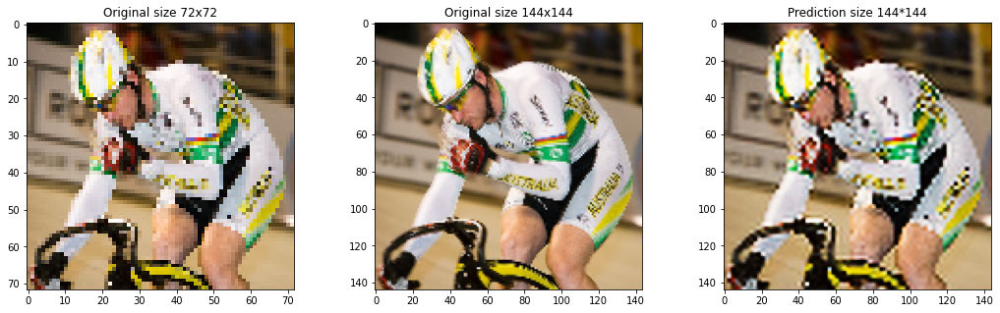

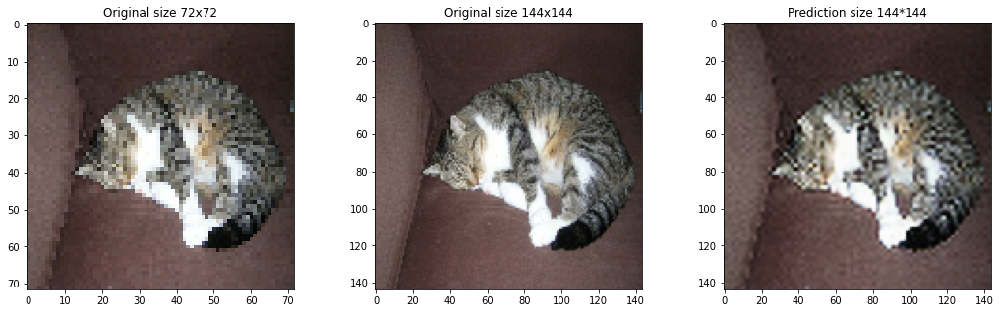

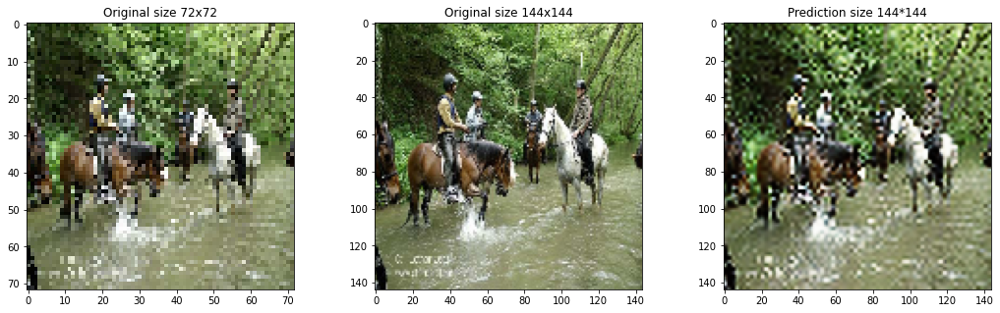

In [29]:
plot_three_images_pred(9,x2,y_mid2,pred1,0)

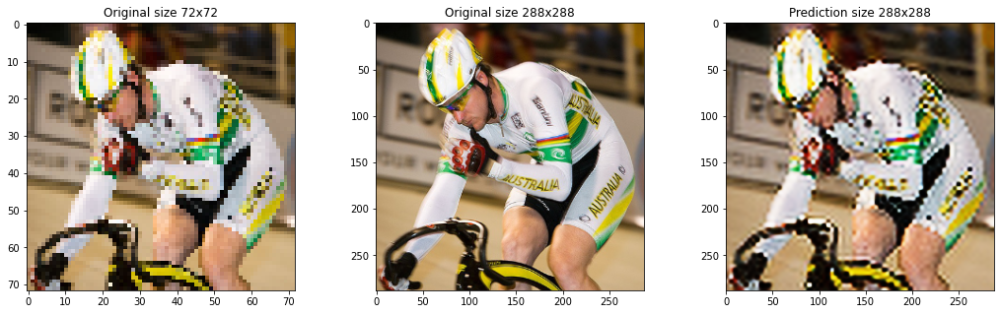

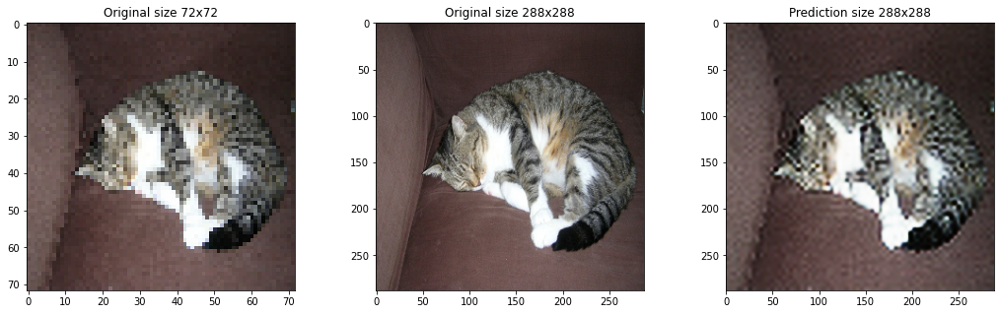

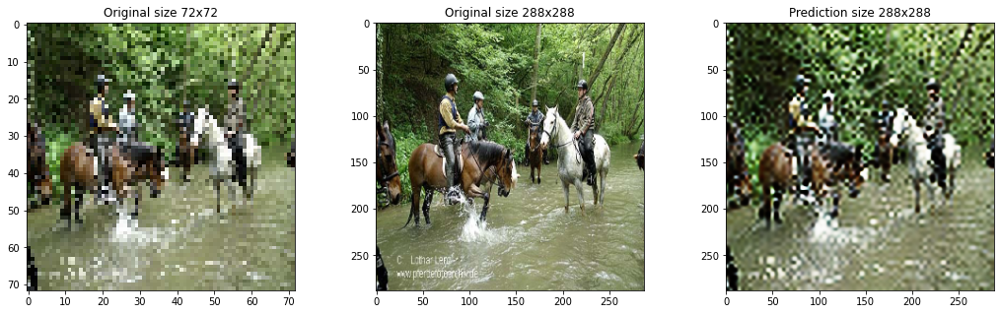

In [30]:
plot_three_images_pred(9,x2,y_large2,pred2,1)

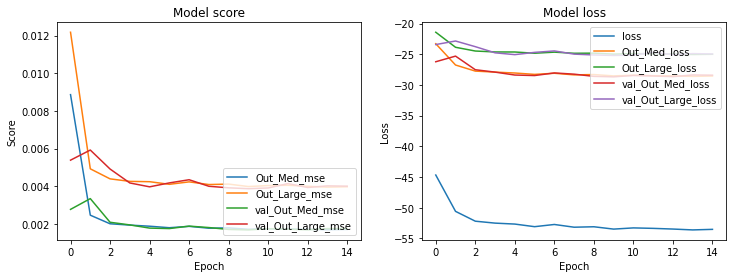

In [31]:
history_to_plot(history_5_1_1, scores_metric_mse, losses)

## **Trainning model 5.1.2 with interpolation nearest and loss PSNR**

In [32]:
history_5_1_2 = model_with_vgg_v2.fit(UnionDataGenerator(new_images_path,16,'nearest','training'),
               callbacks=[create_callbacks('model_5_1_2')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'nearest','validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 89s 356ms/step - loss: -42.6655 - Out_Med_loss: -21.2606 - Out_Large_loss: -21.4048 - Out_Med_acc: 0.8384 - Out_Med_mse: 0.0099 - Out_Large_acc: 0.8429 - Out_Large_mse: 0.0095 - val_loss: -42.9528 - val_Out_Med_loss: -21.4123 - val_Out_Large_loss: -21.5405 - val_Out_Med_acc: 0.8435 - val_Out_Med_mse: 0.0094 - val_Out_Large_acc: 0.8465 - val_Out_Large_mse: 0.0091
Epoch 2/20
250/250 [==============================] - 89s 357ms/step - loss: -43.0109 - Out_Med_loss: -21.4397 - Out_Large_loss: -21.5712 - Out_Med_acc: 0.8431 - Out_Med_mse: 0.0094 - Out_Large_acc: 0.8458 - Out_Large_mse: 0.0091 - val_loss: -43.0463 - val_Out_Med_loss: -21.4609 - val_Out_Large_loss: -21.5855 - val_Out_Med_acc:

In [33]:
pred1,pred2 = model_with_vgg_v2.predict(x2)

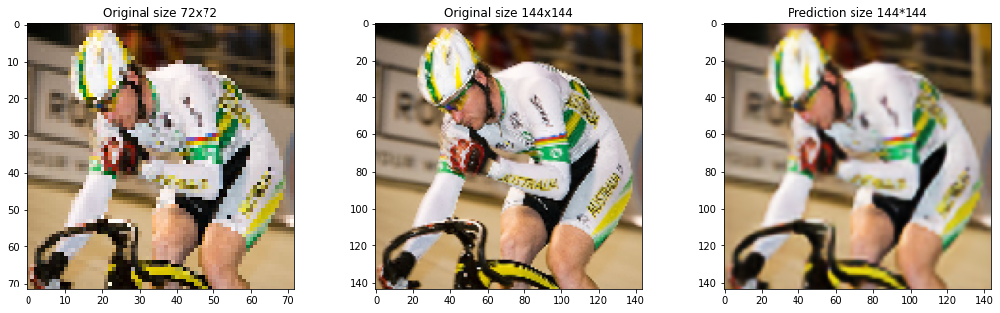

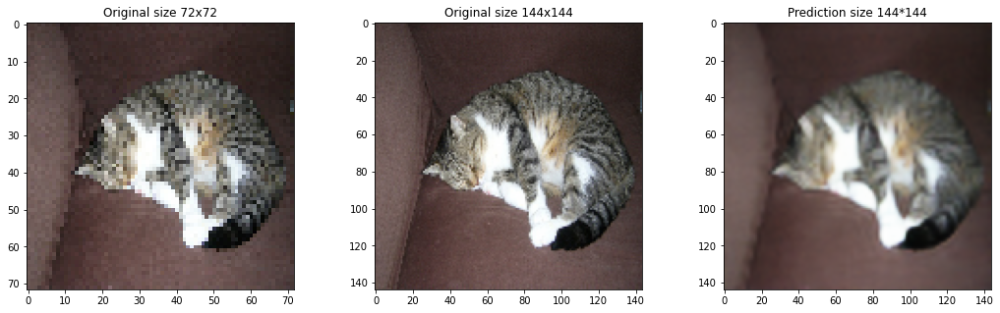

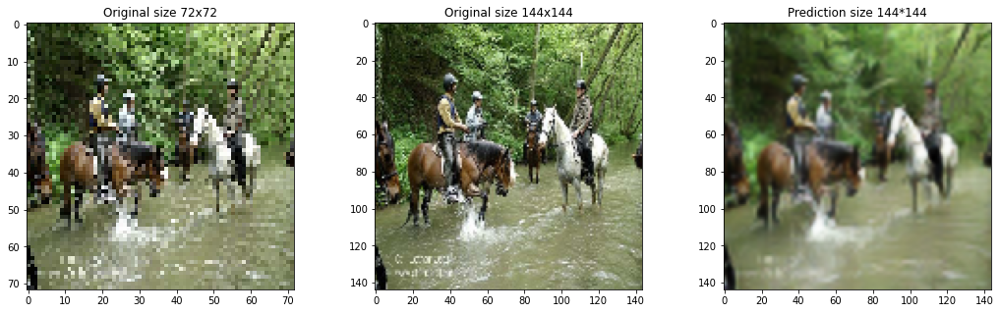

In [34]:
plot_three_images_pred(9,x2,y_mid2,pred1,0)

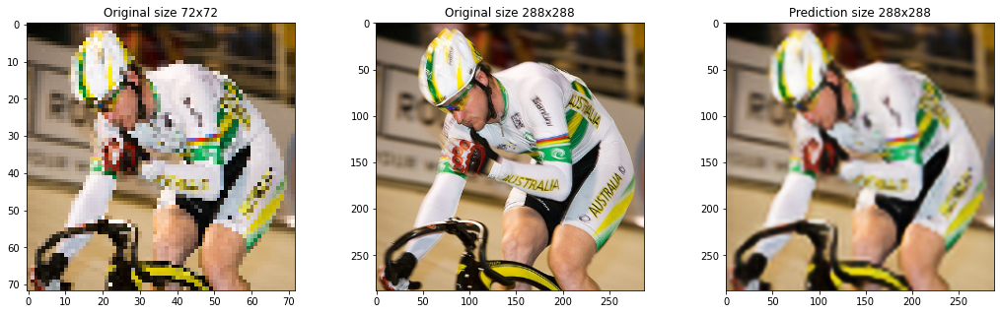

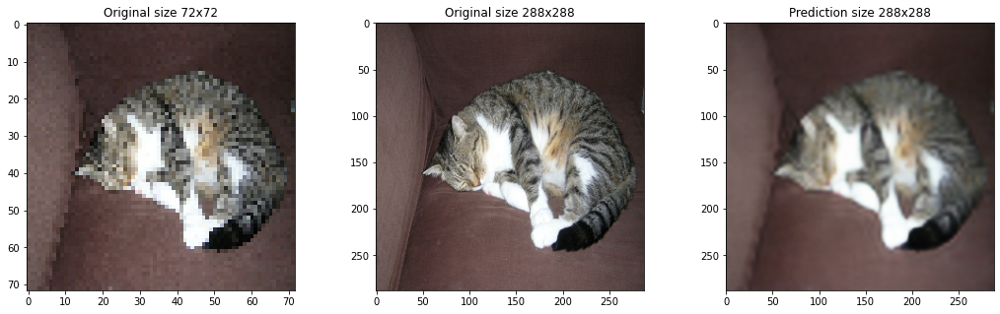

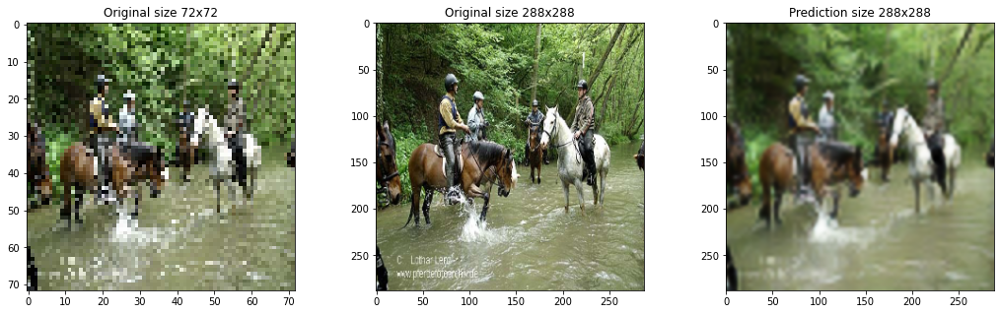

In [35]:
plot_three_images_pred(9,x2,y_large2,pred2,1)

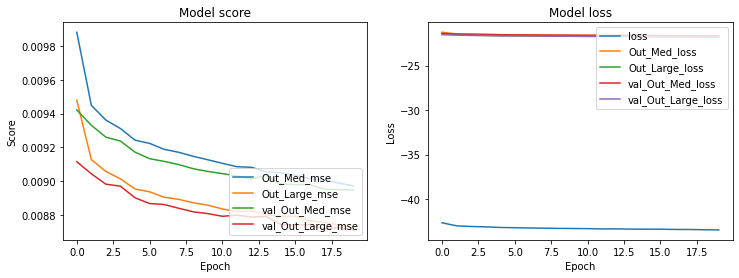

In [36]:
history_to_plot(history_5_1_2, scores_metric_mse, losses)

## **Trainning model 5.1.3 with interpolation bilinear and loss PSNR**

In [37]:
history_5_1_3 = model_with_vgg_v2.fit(UnionDataGenerator(new_images_path,16,'bilinear','training'),
               callbacks=[create_callbacks('model_5_1_3')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'bilinear','validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 102s 408ms/step - loss: -56.6605 - Out_Med_loss: -30.3340 - Out_Large_loss: -26.3265 - Out_Med_acc: 0.8852 - Out_Med_mse: 0.0012 - Out_Large_acc: 0.8634 - Out_Large_mse: 0.0030 - val_loss: -56.8576 - val_Out_Med_loss: -30.4252 - val_Out_Large_loss: -26.4324 - val_Out_Med_acc: 0.8983 - val_Out_Med_mse: 0.0011 - val_Out_Large_acc: 0.8809 - val_Out_Large_mse: 0.0029
Epoch 2/20
250/250 [==============================] - 102s 407ms/step - loss: -57.0353 - Out_Med_loss: -30.5675 - Out_Large_loss: -26.4678 - Out_Med_acc: 0.8924 - Out_Med_mse: 0.0011 - Out_Large_acc: 0.8716 - Out_Large_mse: 0.0029 - val_loss: -57.0601 - val_Out_Med_loss: -30.5713 - val_Out_Large_loss: -26.4888 - val_Out_Med_ac

In [38]:
pred1,pred2 = model_with_vgg_v2.predict(x2)

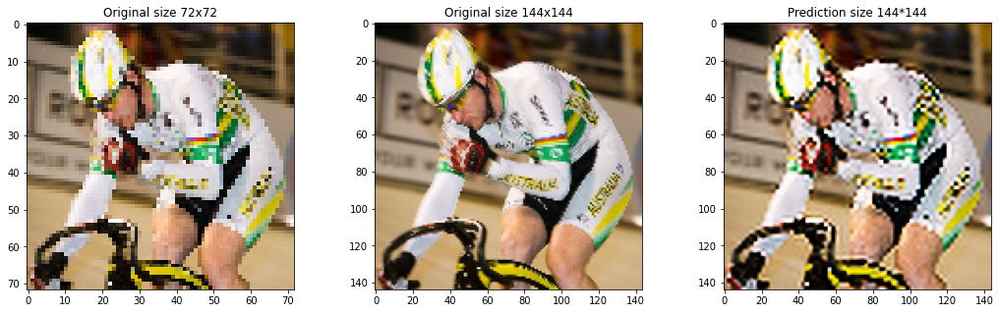

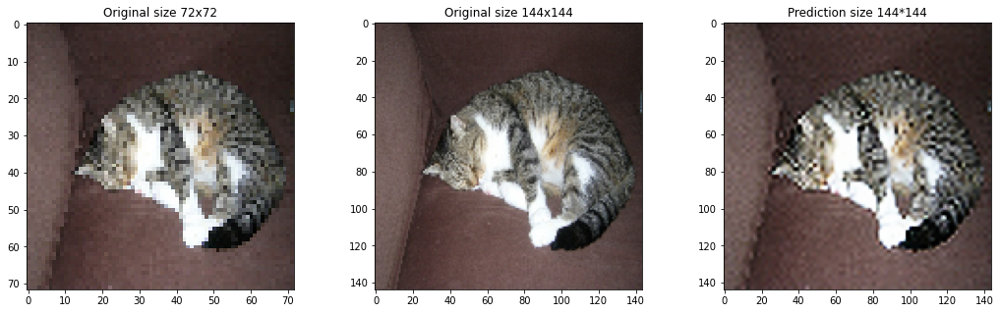

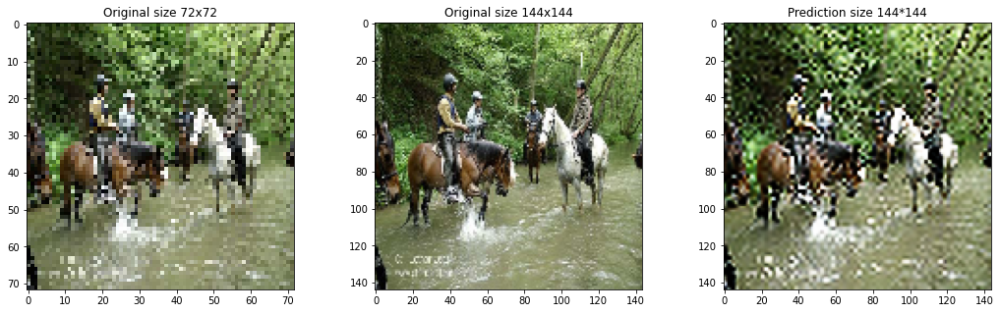

In [39]:
plot_three_images_pred(9,x2,y_mid2,pred1,0)

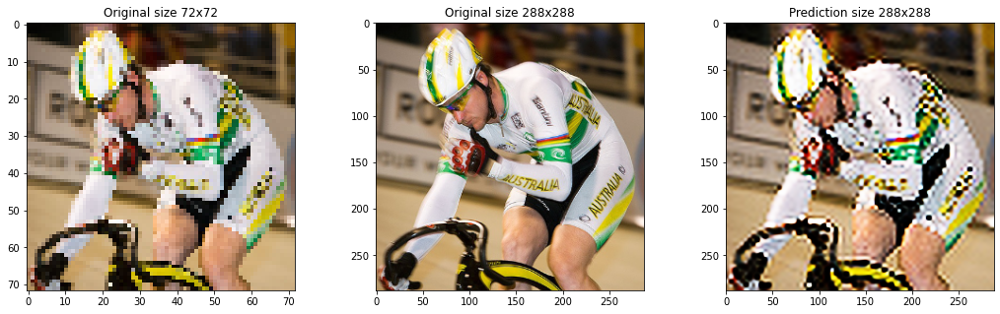

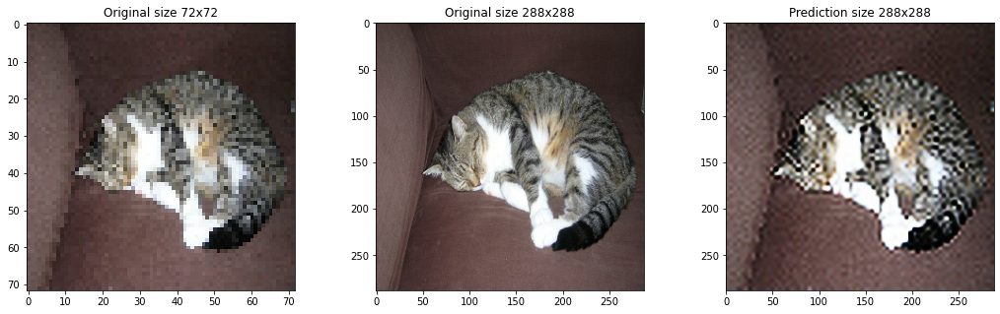

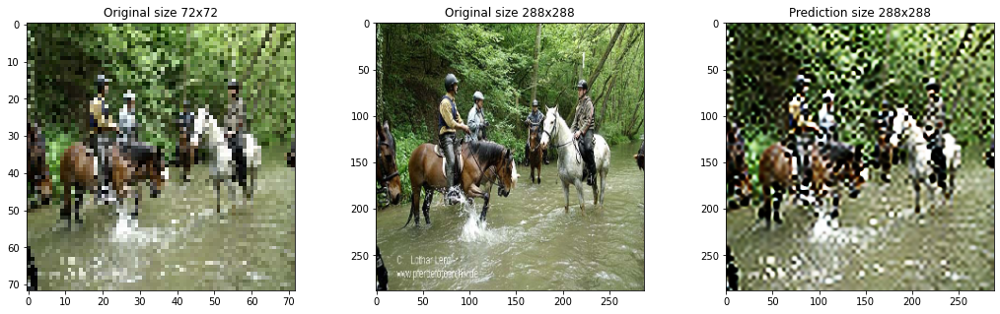

In [40]:
plot_three_images_pred(9,x2,y_large2,pred2,1)

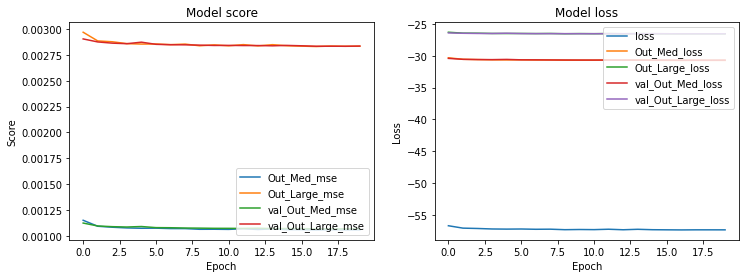

In [41]:
history_to_plot(history_5_1_3, scores_metric_mse, losses)

## **Define model 5.1 with loss as MSE**

In [27]:
def get_model_with_vgg_v2_loss_mse():

  inp = Input(shape=(None,None,3))
  x1 = Conv2D(64,8,activation=Activation(LeakyReLU(alpha=0.2)), padding = 'same')(inp)
  x1 = dilated_conv(64)(x1)
  x1 = dilated_conv(64)(x1)

  x2 = Conv2D(64,4,activation=Activation(LeakyReLU(alpha=0.2)), padding = 'same')(inp)
  x2 = dilated_conv(64)(x2)
  x2 = dilated_conv(64)(x2)

  x3 = Conv2D(64,2,activation=Activation(LeakyReLU(alpha=0.2)), padding = 'same')(inp)
  x3 = dilated_conv(64)(x3)
  x3 = dilated_conv(64)(x3)


  y = fe_model(inp)
  x = concatenate([x1,x2,x3,y],axis=-1)

  x = UpSampling2D(interpolation='bilinear')(x)

  y1 =Conv2D(3,1, padding='same')(x)
  y1 = Activation('sigmoid',name = 'Out_Med')(y1)

  x = Conv2D(64,1)(x)
  
  x = UpSampling2D(interpolation='bilinear')(x)

  y2 = Conv2D(3,1,padding='same')(x)
  y2 = Activation('sigmoid',name = 'Out_Large')(y2)

  model_with_vgg_v2 = Model(inp,[y1,y2])
  model_with_vgg_v2.compile(loss='mse',optimizer='adam',metrics=['acc',PSNR])
  return model_with_vgg_v2

In [28]:
model_with_vgg_v2 = get_model_with_vgg_v2_loss_mse()
model_with_vgg_v2.summary()

Model: "model_7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 6 12352       input_2[0][0]                    
__________________________________________________________________________________________________
conv2d_9 (Conv2D)               (None, None, None, 6 3136        input_2[0][0]                    
__________________________________________________________________________________________________
conv2d_18 (Conv2D)              (None, None, None, 6 832         input_2[0][0]                    
____________________________________________________________________________________________

## **Trainning model 5.1.4 with interpolation bicucic and loss MSE**

In [44]:
history_5_1_4 = model_with_vgg_v2.fit(UnionDataGenerator(new_images_path,16,'bicubic','training'),
               callbacks=[create_callbacks('model_5_1_4')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'bicubic','validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 114s 445ms/step - loss: 0.0685 - Out_Med_loss: 0.0422 - Out_Large_loss: 0.0263 - Out_Med_acc: 0.5510 - Out_Med_PSNR: 17.6211 - Out_Large_acc: 0.6141 - Out_Large_PSNR: 18.5906 - val_loss: 0.0090 - val_Out_Med_loss: 0.0034 - val_Out_Large_loss: 0.0056 - val_Out_Med_acc: 0.7844 - val_Out_Med_PSNR: 25.2755 - val_Out_Large_acc: 0.7938 - val_Out_Large_PSNR: 23.2806
Epoch 2/20
250/250 [==============================] - 110s 440ms/step - loss: 0.0084 - Out_Med_loss: 0.0031 - Out_Large_loss: 0.0053 - Out_Med_acc: 0.7710 - Out_Med_PSNR: 25.7139 - Out_Large_acc: 0.7968 - Out_Large_PSNR: 23.5160 - val_loss: 0.0073 - val_Out_Med_loss: 0.0026 - val_Out_Large_loss: 0.0047 - val_Out_Med_acc: 0.7807 - 

In [45]:
pred1,pred2 = model_with_vgg_v2.predict(x2)

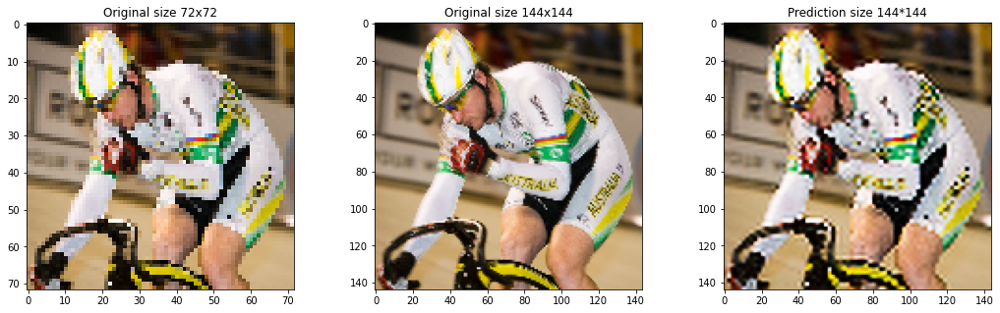

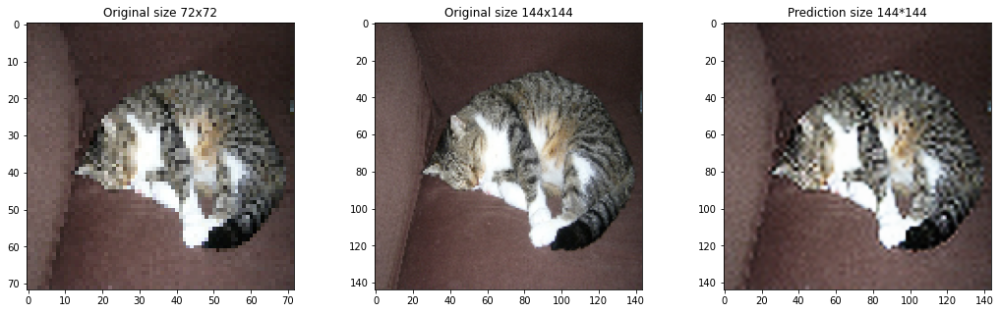

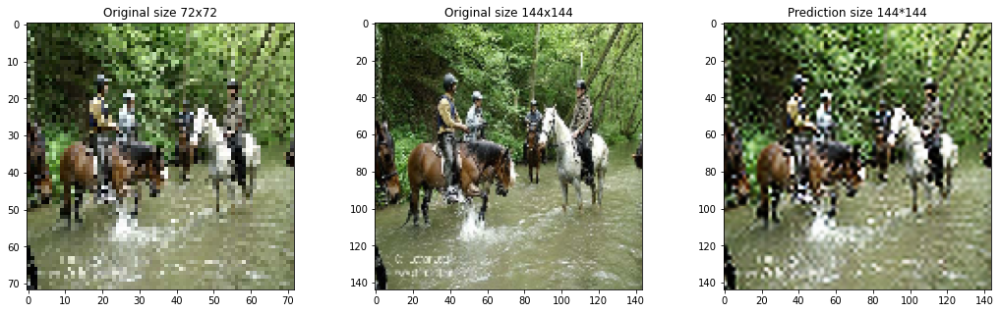

In [46]:
plot_three_images_pred(9,x2,y_mid2,pred1,0)

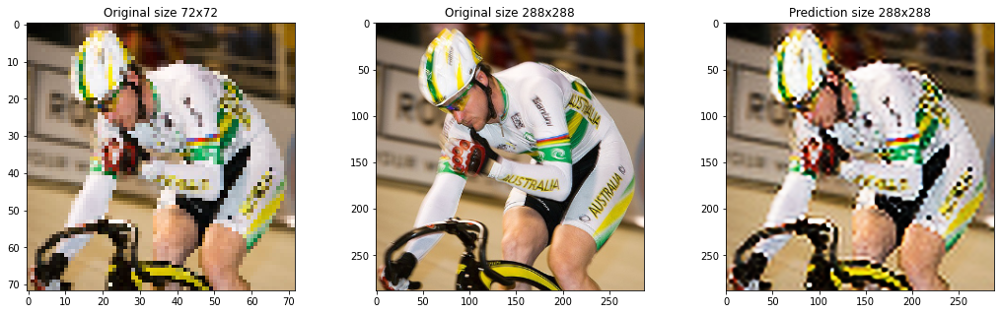

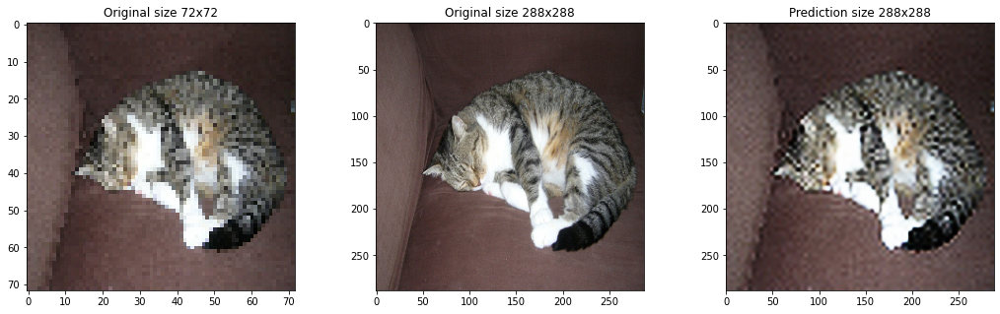

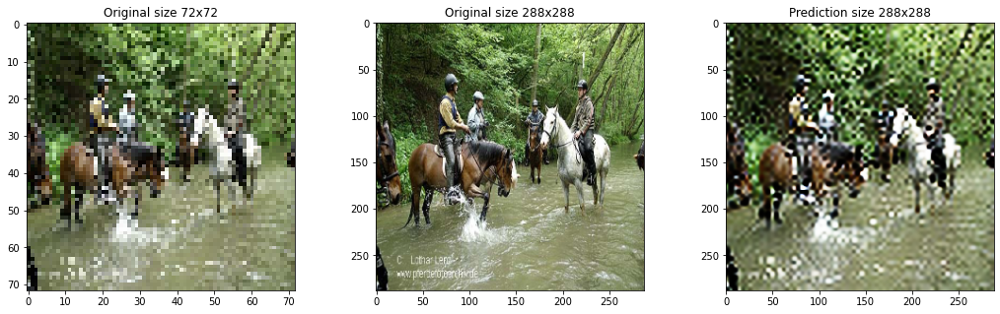

In [47]:
plot_three_images_pred(9,x2,y_large2,pred2,1)

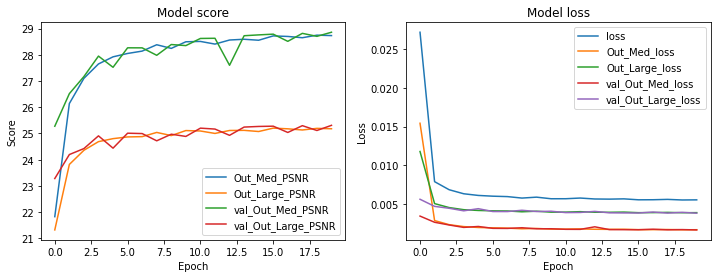

In [48]:
history_to_plot(history_5_1_4, scores_metric_psnr, losses)

## **Trainning model 5.1.5 with interpolation nearest and loss MSE**

In [49]:
history_5_1_5 = model_with_vgg_v2.fit(UnionDataGenerator(new_images_path,16,'nearest','training'),
               callbacks=[create_callbacks('model_5_1_5')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'nearest','validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 88s 353ms/step - loss: 0.1966 - Out_Med_loss: 0.0971 - Out_Large_loss: 0.0996 - Out_Med_acc: 0.5705 - Out_Med_PSNR: 10.7742 - Out_Large_acc: 0.5593 - Out_Large_PSNR: 10.7024 - val_loss: 0.2464 - val_Out_Med_loss: 0.1121 - val_Out_Large_loss: 0.1343 - val_Out_Med_acc: 0.5813 - val_Out_Med_PSNR: 9.8293 - val_Out_Large_acc: 0.5440 - val_Out_Large_PSNR: 8.9331
Epoch 2/20
250/250 [==============================] - 88s 351ms/step - loss: 0.3244 - Out_Med_loss: 0.1657 - Out_Large_loss: 0.1587 - Out_Med_acc: 0.5396 - Out_Med_PSNR: 8.6877 - Out_Large_acc: 0.5379 - Out_Large_PSNR: 8.6762 - val_loss: 0.4563 - val_Out_Med_loss: 0.2533 - val_Out_Large_loss: 0.2031 - val_Out_Med_acc: 0.5591 - val_Ou

In [50]:
pred1,pred2 = model_with_vgg_v2.predict(x2)

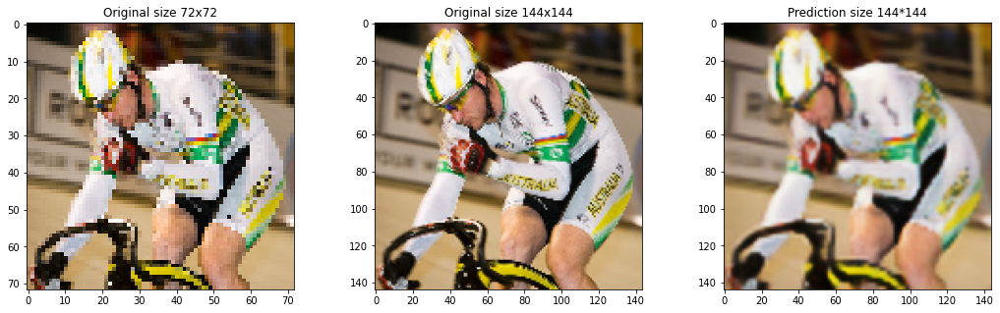

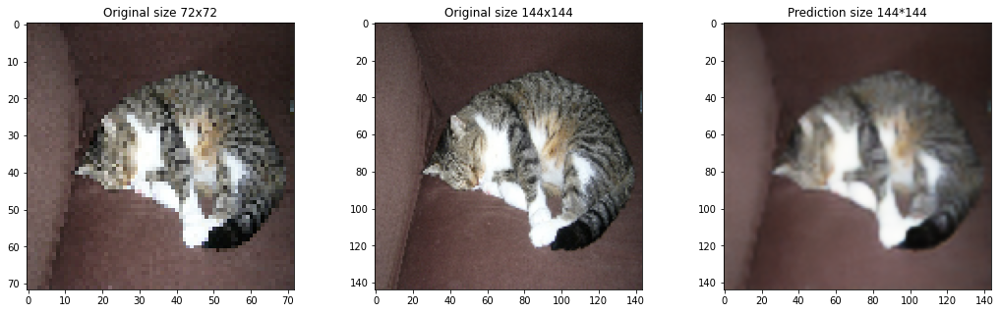

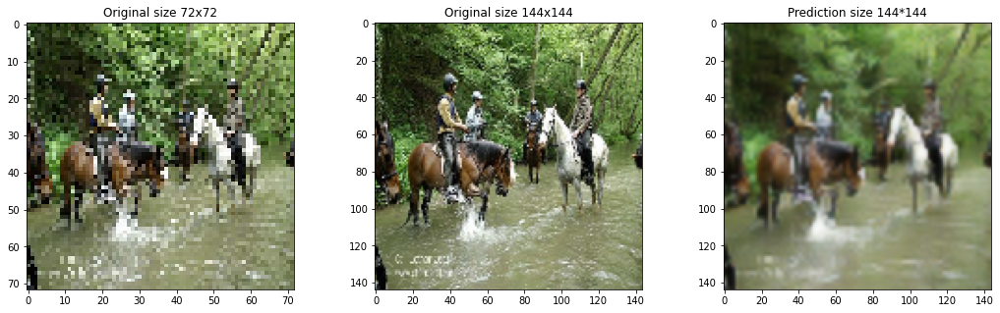

In [51]:
plot_three_images_pred(9,x2,y_mid2,pred1,0)

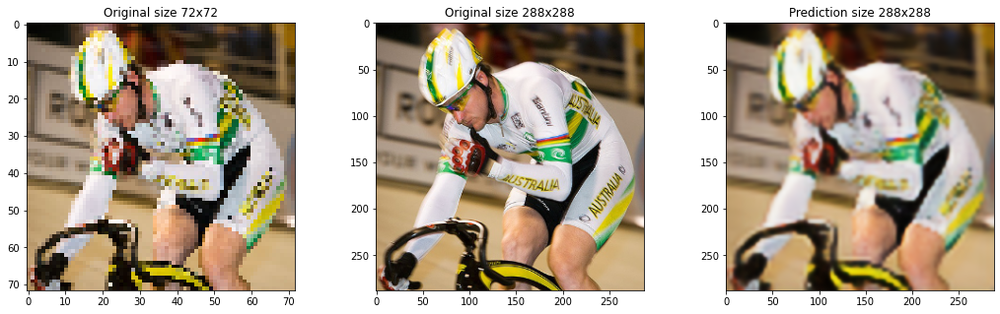

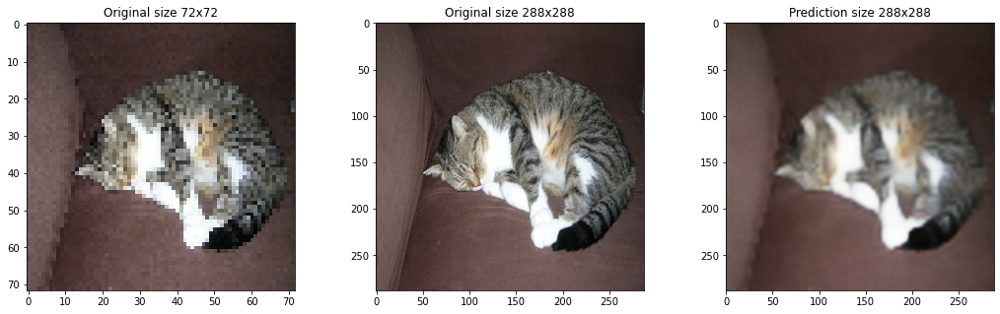

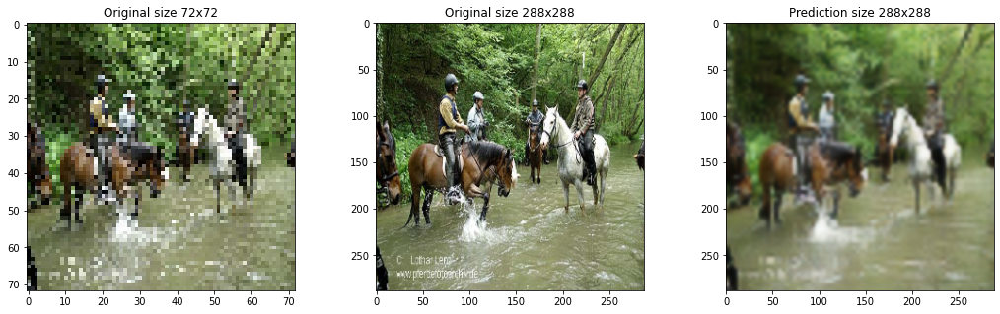

In [52]:
plot_three_images_pred(9,x2,y_large2,pred2,1)

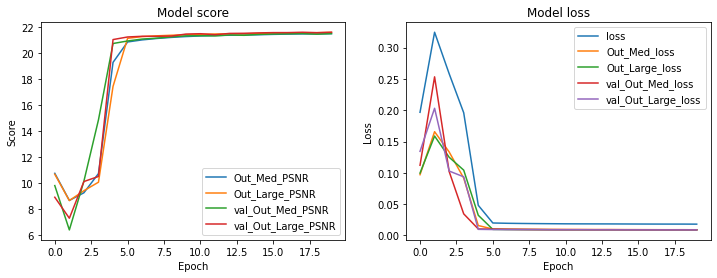

In [53]:
history_to_plot(history_5_1_5, scores_metric_psnr, losses)

## **Trainning model 5.1.6 with interpolation bilinear and loss MSE**

In [29]:
history_5_1_6 = model_with_vgg_v2.fit(UnionDataGenerator(new_images_path,16,'bilinear','training'),
               callbacks=[create_callbacks('model_5_1_6')],
               steps_per_epoch = len(file_list)*0.8//16,
               validation_data = UnionDataGenerator(new_images_path,16,'bilinear','validation'),
               validation_steps = len(file_list)*0.2//16,
               epochs = EPOCHS_NUM)

Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 4009 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Found 1002 images belonging to 1 classes.
Epoch 1/20
250/250 [==============================] - 112s 405ms/step - loss: 0.0659 - Out_Med_loss: 0.0311 - Out_Large_loss: 0.0348 - Out_Med_acc: 0.5793 - Out_Med_PSNR: 18.6008 - Out_Large_acc: 0.5936 - Out_Large_PSNR: 18.5143 - val_loss: 0.0072 - val_Out_Med_loss: 0.0026 - val_Out_Large_loss: 0.0046 - val_Out_Med_acc: 0.7969 - val_Out_Med_PSNR: 26.4029 - val_Out_Large_acc: 0.7836 - val_Out_Large_PSNR: 24.1701
Epoch 2/20
250/250 [==============================] - 100s 400ms/step - loss: 0.0067 - Out_Med_loss: 0.0024 - Out_Large_loss: 0.0043 - Out_Med_acc: 0.7905 - Out_Med_PSNR: 26.8122 - Out_Large_acc: 0.7809 - Out_Large_PSNR: 24.4124 - val_loss: 0.0056 - val_Out_Med_loss: 0.0018 - val_Out_Large_loss: 0.0038 - val_Out_Med_acc: 0.8028 - 

In [30]:
pred1,pred2 = model_with_vgg_v2.predict(x2)

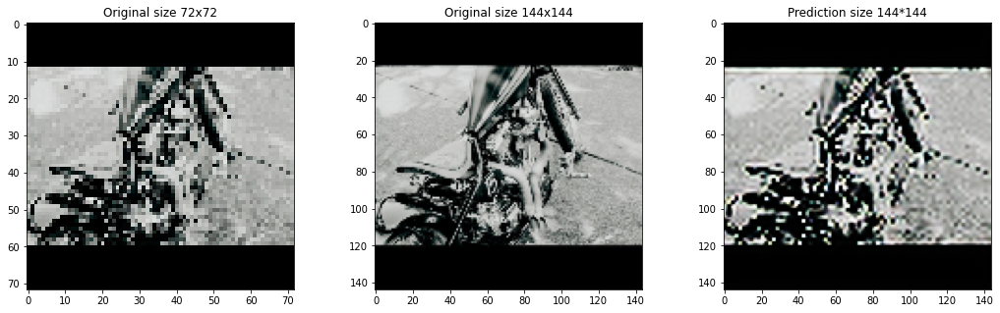

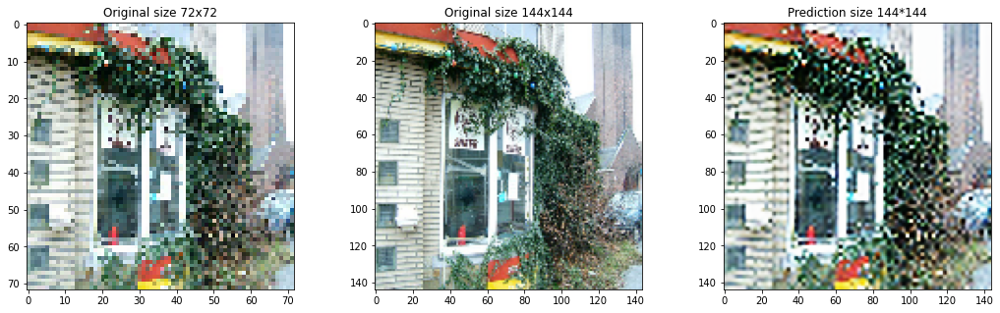

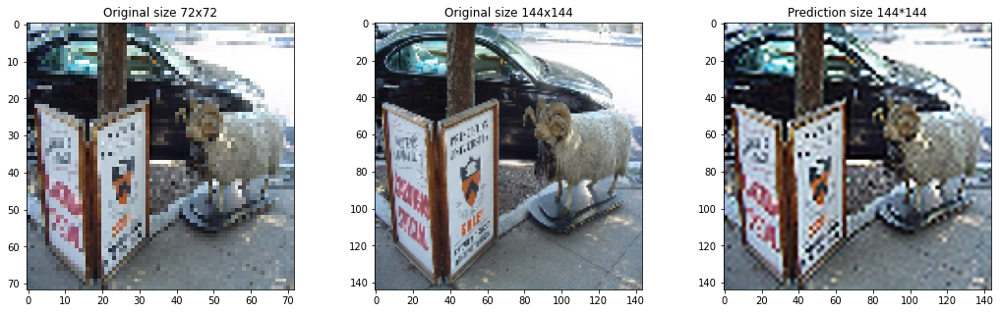

In [31]:
plot_three_images_pred(9,x2,y_mid2,pred1,0)

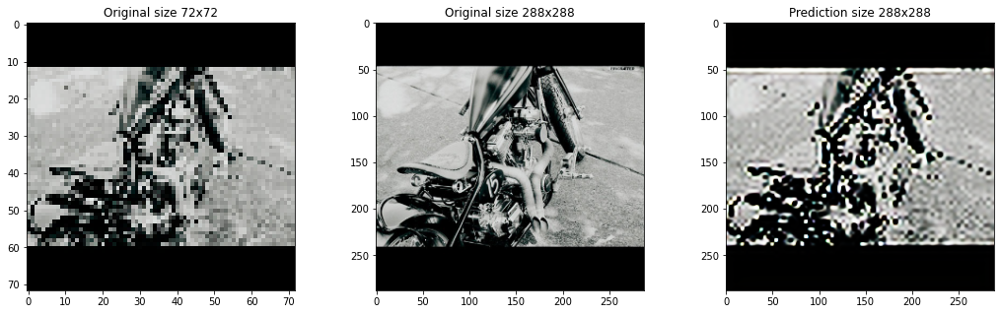

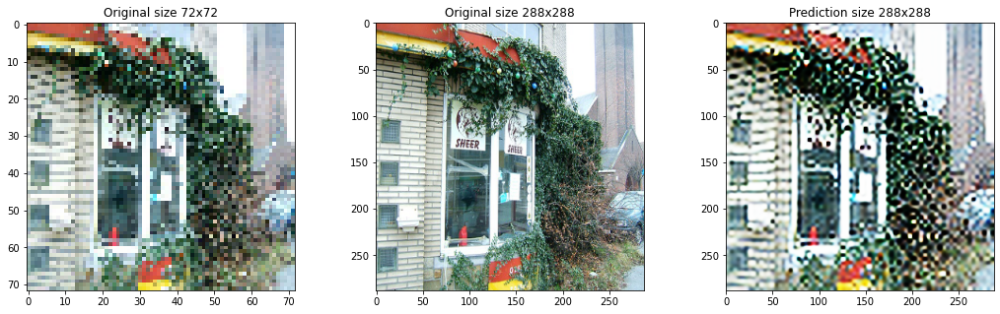

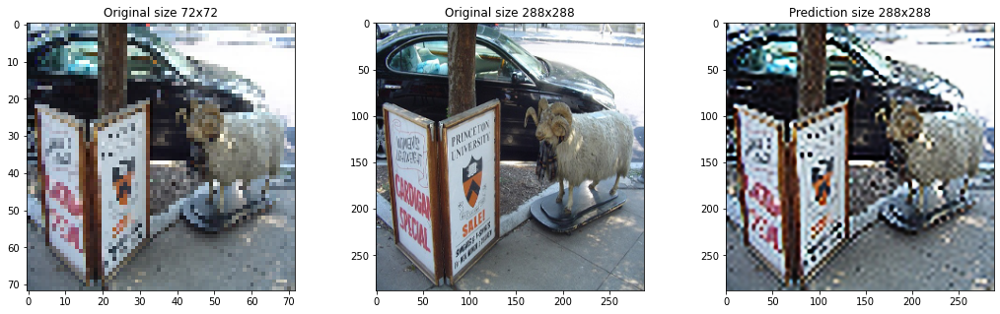

In [32]:
plot_three_images_pred(9,x2,y_large2,pred2,1)

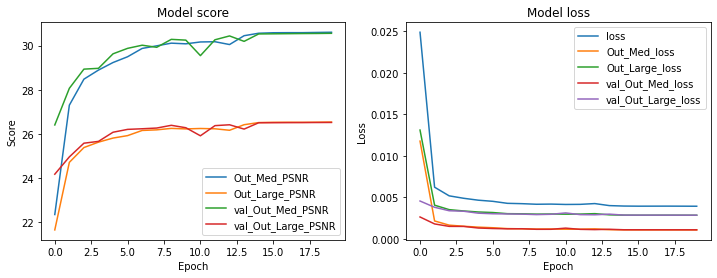

In [33]:
history_to_plot(history_5_1_6, scores_metric_psnr, losses)